<h1>Analysis of dispatch model/Grimsel results<span class="tocSkip"></span></h1>

Complementary material of the paper 
>M.C.Soini *et al.*, **Aspects of the market displacement of incumbent grid-connected electricity storage by more efficient storage**.

This notebook performs all analyses presented in section 3.3 of the paper.
Static HTML files are included with the paper's supplementary material. This assumes the availability of the dispatch model/Grimsel results generated using a separate [Jupyter Notebook]().

**Instructions**
* This assumes a working conda installation
* conda create -y --name grimsel_env python=3.8
* `conda install -y jupyter dask`
* Grimsel and storedisagg, hosted on PyPI, install through `pip install grimsel==X.X.X storedisagg==1.0.1`

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Imports-and-setup" data-toc-modified-id="Imports-and-setup-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Imports and setup</a></span><ul class="toc-item"><li><span><a href="#Auxiliary-tables-and-functions" data-toc-modified-id="Auxiliary-tables-and-functions-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Auxiliary tables and functions</a></span></li></ul></li><li><span><a href="#Default;-future-scenarios" data-toc-modified-id="Default;-future-scenarios-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Default; future scenarios</a></span></li><li><span><a href="#Impact-of-swst_vl" data-toc-modified-id="Impact-of-swst_vl-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Impact of swst_vl</a></span></li><li><span><a href="#Verify-swfz_vl-capacity" data-toc-modified-id="Verify-swfz_vl-capacity-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Verify swfz_vl capacity</a></span></li><li><span><a href="#Verify-swfz_vl-prices" data-toc-modified-id="Verify-swfz_vl-prices-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Verify swfz_vl prices</a></span></li><li><span><a href="#Check:-New-storage-capacity-as-expected" data-toc-modified-id="Check:-New-storage-capacity-as-expected-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Check: New storage capacity as expected</a></span></li><li><span><a href="#Impact-of-swfz_vl" data-toc-modified-id="Impact-of-swfz_vl-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Impact of swfz_vl</a></span></li><li><span><a href="#Storage-capacity" data-toc-modified-id="Storage-capacity-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Storage capacity</a></span></li><li><span><a href="#Displacement-of-storage" data-toc-modified-id="Displacement-of-storage-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Displacement of storage</a></span><ul class="toc-item"><li><span><a href="#Total-discharge-of-both-seasons-by-season" data-toc-modified-id="Total-discharge-of-both-seasons-by-season-9.1"><span class="toc-item-num">9.1&nbsp;&nbsp;</span>Total discharge of both seasons by season</a></span></li><li><span><a href="#Displacement-per-unit-of-installed-new-storage-capacity" data-toc-modified-id="Displacement-per-unit-of-installed-new-storage-capacity-9.2"><span class="toc-item-num">9.2&nbsp;&nbsp;</span>Displacement per unit of installed new storage capacity</a></span><ul class="toc-item"><li><span><a href="#Marginal-displacement" data-toc-modified-id="Marginal-displacement-9.2.1"><span class="toc-item-num">9.2.1&nbsp;&nbsp;</span>Marginal displacement</a></span></li></ul></li><li><span><a href="#Hourly-displacement-analysis" data-toc-modified-id="Hourly-displacement-analysis-9.3"><span class="toc-item-num">9.3&nbsp;&nbsp;</span>Hourly displacement analysis</a></span><ul class="toc-item"><li><span><a href="#Selected-case-of-high-BAT-PHS-operation" data-toc-modified-id="Selected-case-of-high-BAT-PHS-operation-9.3.1"><span class="toc-item-num">9.3.1&nbsp;&nbsp;</span>Selected case of high-BAT PHS operation</a></span></li></ul></li><li><span><a href="#Change-of-the-price-profiles" data-toc-modified-id="Change-of-the-price-profiles-9.4"><span class="toc-item-num">9.4&nbsp;&nbsp;</span>Change of the price profiles</a></span></li><li><span><a href="#Average-operation" data-toc-modified-id="Average-operation-9.5"><span class="toc-item-num">9.5&nbsp;&nbsp;</span>Average operation</a></span></li><li><span><a href="#Capacity-factor" data-toc-modified-id="Capacity-factor-9.6"><span class="toc-item-num">9.6&nbsp;&nbsp;</span>Capacity factor</a></span></li><li><span><a href="#Average-charging-and-discharging-electricity-prices" data-toc-modified-id="Average-charging-and-discharging-electricity-prices-9.7"><span class="toc-item-num">9.7&nbsp;&nbsp;</span>Average charging and discharging electricity prices</a></span></li><li><span><a href="#Analysis-of-large-difference-swec-for-2030" data-toc-modified-id="Analysis-of-large-difference-swec-for-2030-9.8"><span class="toc-item-num">9.8&nbsp;&nbsp;</span>Analysis of large difference swec for 2030</a></span><ul class="toc-item"><li><span><a href="#Total-energy" data-toc-modified-id="Total-energy-9.8.1"><span class="toc-item-num">9.8.1&nbsp;&nbsp;</span>Total energy</a></span></li></ul></li></ul></li><li><span><a href="#Run-storedisagg" data-toc-modified-id="Run-storedisagg-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Run <em>storedisagg</em></a></span><ul class="toc-item"><li><span><a href="#Correlation-with-wind-power-production-by-coarse-bin" data-toc-modified-id="Correlation-with-wind-power-production-by-coarse-bin-10.1"><span class="toc-item-num">10.1&nbsp;&nbsp;</span>Correlation with wind power production by coarse bin</a></span></li><li><span><a href="#Marginal-price-differences/ratios" data-toc-modified-id="Marginal-price-differences/ratios-10.2"><span class="toc-item-num">10.2&nbsp;&nbsp;</span>Marginal price differences/ratios</a></span></li></ul></li><li><span><a href="#Storage-properties" data-toc-modified-id="Storage-properties-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>Storage properties</a></span></li></ul></div>

# Imports and setup

In [24]:
from dask.distributed import Client
client = Client(dashboard_address='127.0.0.1:41012', n_workers=10)
client

Client Scheduler: tcp://127.0.0.1:34595 Dashboard: http://127.0.0.1:43379/status,Cluster Workers: 10 Cores: 30 Memory: 133.72 GB


In [8]:
client.restart()

distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker


Client Scheduler: tcp://127.0.0.1:33763 Dashboard: http://127.0.0.1:39459/status,Cluster Workers: 10 Cores: 30 Memory: 133.72 GB


In [ ]:
import sys, os
import re
from glob import glob
import itertools
import numpy as np
import pandas as pd
import dask.dataframe as dd
import pandas as pd
from dask import delayed
from fastparquet import ParquetFile

import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from IPython.display import Image

import grimsel.auxiliary.maps as maps

# Directory with model result parquet files
sc_out = 'out_grimsel/'

## Auxiliary tables and functions

In [27]:
print_full = pd.option_context('display.max_rows', None, 
                               'display.max_columns', None)

# conversion between ids and names of power plants, nodes, etc
mps = maps.Maps.from_parquet(sc_out)

# table defining model runs
def_run = pd.read_parquet(sc_out + 'def_run.parq')
# timemap table defining hours of the year
dict_mt2 = {mt: k for k, v in {'Summer': [4, 5, 6, 7, 8, 9],
                               'Winter': [0, 1, 2, 3, 10, 11]}.items() for mt in v}
df_tm_soy_full = (pd.read_parquet(sc_out + 'tm_soy_full.parq')
                    .assign(season2=lambda x: x.mt_id.replace(dict_mt2)))

# list of columns defining model variations
sw_cols = [c for c in def_run.columns if re.match('^sw.*vl$', c)]

def get_file_list(glob_in, slct_run_id=None):
    if not slct_run_id:
        slct_run_id = def_run.run_id
    
    files = [fn for fn in glob_in if any(fn.endswith('{:04d}.parq'.format(run_id)) for run_id in slct_run_id)]
    return sorted(files)

def ddf_from_parquet(pattern, slct_run_id=None, as_df=False, columns=None):
    '''Read all parquet files of a certain file name pattern with certain run_ids'''
    @delayed
    def load_chunk(pth, columns):
        return ParquetFile(pth).to_pandas(columns=columns)#.set_index('run_id')

    files = get_file_list(glob(sc_out + pattern), slct_run_id)
    assert len(files) > 0, f'Pattern {sc_out + pattern} yields empty file list.'
    ddf = dd.from_delayed([load_chunk(f, columns=columns) for f in files])
    if as_df:
        ddf = ddf.compute()
    
    return ddf
    
def ddf_add_tm_cols(ddf, tm_cols):
    '''Join timemap tables'''
    return ddf.join(df_tm_soy_full.set_index('sy')[tm_cols], on='sy')

In [28]:
ls compare_repro/

def_encar.parq    def_week.parq                   parameter_month.parq
def_fuel.parq     fuel_node_encar.parq            plant_encar.parq
def_month.parq    fuel_node_encar_scenarios.parq  plant_encar_scenarios.parq
def_node.parq     hoy_soy.parq                    plant_month.parq
def_plant.parq    hydro.parq                      sy_min_all.parq
def_pp_type.parq  node_connect.parq               tm_soy_full.parq
def_profile.parq  node_encar.parq                 tm_soy.parq


In [32]:
!ls compare_repro

def_encar.parq	  def_week.parq			  parameter_month.parq
def_fuel.parq	  fuel_node_encar.parq		  plant_encar.parq
def_month.parq	  fuel_node_encar_scenarios.parq  plant_encar_scenarios.parq
def_node.parq	  hoy_soy.parq			  plant_month.parq
def_plant.parq	  hydro.parq			  sy_min_all.parq
def_pp_type.parq  node_connect.parq		  tm_soy_full.parq
def_profile.parq  node_encar.parq		  tm_soy.parq


In [31]:
df_new = pd.concat([pd.read_csv(fn) for fn in glob.glob(os.path.join('compare_repro', 'def_run*.csv'))])

#df_new = pd.read_parquet(os.path.join('compare_repro', 'def_run.parq'))

df_old = pd.read_parquet('out_value_test_all6hours/def_run.parq')

ValueError: No objects to concatenate

In [22]:
df_comp = df_new.set_index('run_id')[[c for c in df_new.columns if c.endswith('_vl')] + ['objective']
                          ].join(df_old.set_index('run_id').objective.rename('obj_new')).assign(dff=lambda x: x.objective - x.obj_new)
df_comp.assign(ddf_abs=df_comp.dff.abs()).sort_values('ddf_abs')

,swfy_vl,swfz_vl,swst_vl,swec_vl,objective,obj_new,dff,ddf_abs
run_id,,,,,,,,
16,yr2015,frz_vc,0.0%,early_phs,2.780603e+10,2.780603e+10,0.002586,0.002586
8,yr2015,frz_cap,0.0%,early_phs,2.780603e+10,2.780603e+10,0.002586,0.002586
0,yr2015,default,0.0%,early_phs,2.780603e+10,2.780603e+10,0.002586,0.002586
828,yr2050,frz_cap,30.0%,early_bat,8.232914e+10,8.232914e+10,-0.002701,0.002701
67,yr2040,frz_vc,20.0%,early_phs,4.132252e+10,4.132252e+10,-0.003563,0.003563
...,...,...,...,...,...,...,...,...
788,yr2050,frz_vc,10.0%,early_bat,4.010384e+10,4.010384e+10,1.025078,1.025078
27,yr2040,default,10.0%,early_phs,9.350976e+10,9.350976e+10,-1.085281,1.085281
793,yr2020,default,20.0%,early_bat,3.892185e+10,3.892185e+10,-1.564148,1.564148


In [4]:
ddf_var_sy_pwr = ddf_from_parquet('var_sy_pwr*')
df_pp_sum = ddf_var_sy_pwr.groupby(['run_id', 'pp_id', 'bool_out']).value.sum().compute().reset_index()

In [48]:
df_tm = pd.read_parquet(sc_out + 'tm_soy_full.parq').set_index('sy')[['hour']]

ddf_var_sy_pwr_hourly = ddf_var_sy_pwr.join(df_tm, on='sy')
ddf_var_sy_pwr_hourly = ddf_var_sy_pwr_hourly.groupby(['pp_id', 'bool_out', 'hour', 'ca_id', 'run_id']).value.sum()

df_var_sy_pwr_hourly = ddf_var_sy_pwr_hourly.compute()
df_var_sy_pwr_hourly = mps.id_to_name(df_var_sy_pwr_hourly.reset_index())

df_var_sy_pwr_hourly.head()

,pp_id,bool_out,hour,ca_id,run_id,value,pt_id,fl_id,nd_id,pp,ca,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,pt,fl,nd
0,0,False,0,0,0,7259.490644,0,12,2,DE_HYD_RES,EL,yr2015,default,000%,early_phs,default,HYD_RES,reservoir,DE0
1,0,False,1,0,0,9053.900267,0,12,2,DE_HYD_RES,EL,yr2015,default,000%,early_phs,default,HYD_RES,reservoir,DE0
2,0,False,2,0,0,22518.814830,0,12,2,DE_HYD_RES,EL,yr2015,default,000%,early_phs,default,HYD_RES,reservoir,DE0
3,0,False,3,0,0,47106.686535,0,12,2,DE_HYD_RES,EL,yr2015,default,000%,early_phs,default,HYD_RES,reservoir,DE0
4,0,False,4,0,0,134063.205417,0,12,2,DE_HYD_RES,EL,yr2015,default,000%,early_phs,default,HYD_RES,reservoir,DE0


In [26]:
ddf_cap_sum = ddf_from_parquet('var_yr_cap_pwr_tot*')
df_cap_sum = ddf_cap_sum.compute()

ddf_caperg_sum = ddf_from_parquet('var_yr_cap_erg_tot*')
ddf_dischdur = ddf_from_parquet('par_disch*')

ddf_caperg_sum = dd.merge(ddf_caperg_sum, ddf_dischdur, on=['pp_id', 'ca_id', 'run_id'], 
                          suffixes=('caperg', 'discharge'), how='left')

df_caperg_sum = ddf_caperg_sum.compute()

TypeError: 'module' object is not callable

In [51]:
df_pp_sum = mps.id_to_name(df_pp_sum.reset_index())
df_cap_sum = mps.id_to_name(df_cap_sum.reset_index())
df_caperg_sum = mps.id_to_name(df_caperg_sum)

In [52]:
df_pp_sum.head()

,index,run_id,pp_id,bool_out,value,pt_id,fl_id,nd_id,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,pp,pt,fl,nd
0,0,0,0,False,3.671570e+06,0,12,2,yr2015,default,000%,early_phs,default,DE_HYD_RES,HYD_RES,reservoir,DE0
1,1,0,1,False,1.511803e+07,0,12,0,yr2015,default,000%,early_phs,default,AT_HYD_RES,HYD_RES,reservoir,AT0
2,2,0,2,False,2.201464e+07,0,12,1,yr2015,default,000%,early_phs,default,CH_HYD_RES,HYD_RES,reservoir,CH0
3,3,0,3,False,2.683357e+07,0,12,4,yr2015,default,000%,early_phs,default,IT_HYD_RES,HYD_RES,reservoir,IT0
4,4,0,4,False,2.088421e+07,0,12,3,yr2015,default,000%,early_phs,default,FR_HYD_RES,HYD_RES,reservoir,FR0


# Default; future scenarios

In [53]:
slct_run_id = def_run.loc[def_run.swfz_vl.isin(['default'])
                       & def_run.swst_vl.isin(['000%'])
                       & def_run.swec_vl.isin(['early_phs'])].run_id.tolist()
print(slct_run_id)
df_pp_sum_default = df_pp_sum.loc[df_pp_sum.run_id.isin(slct_run_id)]
df_cap_sum_default = df_cap_sum.loc[df_cap_sum.run_id.isin(slct_run_id)]
df_pp_sum_default.loc[df_pp_sum_default.bool_out, 'value'] *= -1

[5, 7, 1, 2, 3, 4, 0, 6]


/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [55]:

data = df_pp_sum_default.assign(value=df_pp_sum_default.value / 1e6)
fig = px.bar(data.sort_values('swfy_vl'), x='swfy_vl', y='value', hover_data=['fl'],
       facet_col='nd', color='fl',
       labels={'value': 'Energy (TWh/yr)', 'swfy_vl': 'Year'})
fig.update_yaxes(matches=None)

In [11]:
data = df_cap_sum_default.assign(value=df_cap_sum_default.value / 1e3)
fig = px.bar(data, x='swfy_vl', y='value', hover_data=['fl'],
       facet_col='nd', color='pt', 
       labels={'value': 'Installed capacity (GW)', 'swfy_vl': 'Year'})
fig.update_yaxes(matches=None)

# Impact of swst_vl

In [12]:
slct_run_id = def_run_slct.loc[def_run_slct.swfz_vl.isin(['default', 'frz_hydres'])
                             & def_run_slct.swec_vl.isin(['early_phs'])].run_id.tolist()
print(slct_run_id)
df_pp_sum_swst = df_pp_sum.loc[df_pp_sum.run_id.isin(slct_run_id)]
df_pp_sum_swst.loc[df_pp_sum_swst.bool_out, 'value'] *= -1

[1, 4, 13, 16, 25, 28, 37, 40, 49, 52, 61, 64, 2, 5, 14, 17, 26, 29, 38, 41, 50, 53, 62, 65, 0, 3, 12, 15, 24, 27, 36, 39, 48, 51, 60, 63]


/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [13]:
## Impact by swst_vl

join_cols = list(set(sw_cols) - {'swst_vl'} | {'bool_out', 'pp_id'})

data = df_pp_sum_swst.query('bool_out == False').assign(value=lambda x: x.value / 1e6)
data_ref = data.loc[data.swst_vl == '0.0%'].set_index(join_cols).value.rename('value_ref')
data = data.join(data_ref, on=join_cols).assign(value_diff=lambda x: x.value - x.value_ref)

In [14]:
fig = px.bar(data, x='swst_vl', y='value_diff', hover_data=['fl', 'bool_out'] + sw_cols,
       facet_col='nd', facet_row='swfy_vl', color='fl', 
       labels={'value': 'Installed capacity (GW)', 'swfy_vl': 'Year'})
fig.update_yaxes(matches=None)

In [15]:
slct_run_id = def_run_slct.loc[def_run_slct.swst_vl.isin(['0.0%', '100.0%'])
                             & def_run_slct.swfz_vl.isin(['default', 'frz_hydres'])
                             & def_run_slct.swec_vl.isin(['early_phs'])].run_id.tolist()
print(slct_run_id)
df_var_sy_pwr_hourly = df_var_sy_pwr_hourly.loc[df_var_sy_pwr_hourly.run_id.isin(slct_run_id)]
df_var_sy_pwr_hourly.loc[df_var_sy_pwr_hourly.bool_out, 'value'] *= -1

[1, 4, 61, 64, 2, 5, 62, 65, 0, 3, 60, 63]


# Verify swfz_vl capacity

In [52]:
slct_run_id = def_run.query('swst_vl in ["000%", "050%"] '
                            ' and swfy_vl in ["yr2015", "yr2030", "yr2050"]').run_id.tolist()
dfcap = (ddf_from_parquet('par_cap_pwr_leg*', slct_run_id=slct_run_id)
                 .assign(pt_id=lambda x: x.pp_id.replace(mps.dict_plant_2_pp_type_id))
                 .groupby(['run_id', 'pt_id']).value.sum().reset_index()
                 .compute())
dfcap = dfcap.loc[~dfcap.pt_id.isin(mps.pt2pt('LOL'))]
dfcap = mps.id_to_name(dfcap)

dfcap['run_no_fz'] = dfcap[set(sw_cols) - {'swfz_vl', 'swst_vl'}].apply(tuple, axis=1).astype(str)
dfcap

px.bar(dfcap, x='run_no_fz', y='value', color='pt', facet_col='swfz_vl', facet_row='swst_vl')

# Verify swfz_vl prices

In [108]:
slct_run_id = def_run.query('swst_vl in ["000%", "050%"] '
                            ' and swfy_vl in ["yr2015", "yr2030", "yr2050"]').run_id.tolist()
dfvcfl = ddf_from_parquet('par_vc_fl*', slct_run_id=slct_run_id)
dfvcfl = dfvcfl.loc[~dfvcfl.fl_id.isin(mps.fl2fl('lost'))
                   & dfvcfl.nd_id.isin([2])]
dfvcfl = dfvcfl.loc[dfvcfl.mt_id == 0].compute()
dfvcfl = mps.id_to_name(dfvcfl)

dfvcfl['run_no_fz'] = dfvcfl[set(sw_cols) - {'swfz_vl', 'swst_vl', 'swfy_vl'}].apply(tuple, axis=1).astype(str)
dfvcfl

fig = px.bar(dfvcfl, x='swfy_vl', y='value', color='fl', 
             facet_col='swfz_vl', facet_row='swst_vl')
fig#.update_layout(barmode='group')


# Check: New storage capacity as expected

In [4]:
slct_run_id = def_run.query('swfy_vl in ["yr2015", "yr2030", "yr2050"]').run_id.tolist()
dfcap = ddf_from_parquet('var_yr_cap_erg_tot*', slct_run_id=slct_run_id)
dfcap = dfcap.loc[dfcap.pp_id.isin(mps.pp2pp('STO'))].compute()

dfcap['pt_id'] = dfcap.pp_id.replace(mps.dict_plant_2_pp_type_id)
dfcap['nd_id'] = dfcap.pp_id.replace(mps.dict_plant_2_node_id)

dfcap = (dfcap.pivot_table(index=['run_id', 'nd_id'], columns='pt_id', values='value')
              .assign(value= lambda x: x[mps.dict_pt_id['NEW_STO']] / x[mps.dict_pt_id['HYD_STO']])
              .reset_index())[['run_id', 'nd_id', 'value']]
dfcap = mps.id_to_name(dfcap)

px.scatter(dfcap, x='swst_vl', y='value', facet_col='nd', height=300)

# Impact of swfz_vl

In [5]:
slct_run_id = def_run.query('swst_vl in ["000%", "100%", "200%"]'
                            ' and swfy_vl in ["yr2015", "yr2020", "yr2030", "yr2050"]'
                           ).run_id.tolist()

In [6]:
join_cols = list(set(sw_cols) - {'swst_vl'} | {'hour', 'bool_out', 'pp_id'})

data = df_var_sy_pwr_hourly.reset_index().query('bool_out == False').assign(value=lambda x: x.value / 1e6)
data_ref = data.loc[data.swst_vl == '0.0%'].set_index(join_cols).value.rename('value_ref')
data = data.join(data_ref, on=join_cols).assign(value_diff=lambda x: x.value - x.value_ref)
data = data.groupby(sw_cols + ['pt', 'fl', 'hour', 'bool_out', ])[['value', 'value_diff']].sum().reset_index()

join_cols = list(set(join_cols) - {'pp_id'})

NameError: name 'df_var_sy_pwr_hourly' is not defined

In [7]:
data.loc[#data.hour.isin([0])
         
    data.fl.isin(['reservoir']) 
         & data.swfy_vl.isin(['yr2015'])].pivot_table(index='hour', columns=['swfz_vl', 'swst_vl'], values='value')

NameError: name 'data' is not defined

In [18]:
fig = px.bar(data.query('swst_vl == "100.0%" and swec_vl == "early_phs" and bool_out == False and fl in ["pumped_hydro", "photovoltaic", "new_storage", "reservoir"]' ), x='hour', y='value_diff',
             hover_data=['fl', 'bool_out'] + join_cols,
       facet_col='swfz_vl', facet_row='swfy_vl', color='fl', 
       labels={'value': 'Installed capacity (GW)', 'swfy_vl': 'Year'})
fig

# Storage capacity

In [19]:
df_caperg_sum = df_caperg_sum.query('fl in ["pumped_hydro", "new_storage"]')
df_caperg_sum.head()
df_caperg_sum_agg = df_caperg_sum.groupby(sw_cols + ['nd', 'fl', 'pp']).valuecaperg.apply(sum).reset_index()


In [20]:
df_caperg_sum_agg.query('swfy_vl=="yr2015" and swfz_vl == "default" and swst_vl == "0.0%"')

,swfy_vl,swfz_vl,swst_vl,swec_vl,nd,fl,pp,valuecaperg
0,yr2015,default,0.0%,early_bat,AT0,new_storage,AT_NEW_STO,0.000000
1,yr2015,default,0.0%,early_bat,AT0,pumped_hydro,AT_HYD_STO,13485.454757
2,yr2015,default,0.0%,early_bat,CH0,new_storage,CH_NEW_STO,0.000000
3,yr2015,default,0.0%,early_bat,CH0,pumped_hydro,CH_HYD_STO,39045.500248
4,yr2015,default,0.0%,early_bat,DE0,new_storage,DE_NEW_STO,0.000000
5,yr2015,default,0.0%,early_bat,DE0,pumped_hydro,DE_HYD_STO,46797.386139
6,yr2015,default,0.0%,early_bat,FR0,new_storage,FR_NEW_STO,0.000000
7,yr2015,default,0.0%,early_bat,FR0,pumped_hydro,FR_HYD_STO,101675.018440
8,yr2015,default,0.0%,early_bat,IT0,new_storage,IT_NEW_STO,0.000000
9,yr2015,default,0.0%,early_bat,IT0,pumped_hydro,IT_HYD_STO,21798.237624


In [21]:
data = df_caperg_sum_agg.query('swfz_vl == "default"')
fig = px.bar(data, x='swst_vl', y='valuecaperg', hover_data=['fl'],
       facet_col='swfy_vl', facet_row='swec_vl', color='pp', 
       labels={'valuecaperg': 'Installed capacity (GWh)', 'swst_vl': 'Storage capacity share'}
            )
fig

# Displacement of storage

In [4]:
def_run


,tdiff_solve,tdiff_write,run_id,info,swfy_id,swfz_id,swst_id,swec_id,swch_id,swfy,swfz,swst,swec,swch,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,objective
0,264.865605,4.558086,746,Solver: optimal,2,0,0,1,0,2.0,0.0,0.0,1.0,0.0,yr2030,default,000%,early_bat,default,6.073229e+10
1,262.169828,4.466177,754,Solver: optimal,2,1,0,1,0,2.0,1.0,0.0,1.0,0.0,yr2030,frz_cap,000%,early_bat,default,5.615084e+10
2,273.094901,4.314879,762,Solver: optimal,2,2,0,1,0,2.0,2.0,0.0,1.0,0.0,yr2030,frz_vc,000%,early_bat,default,2.995254e+10
3,277.728524,4.391038,770,Solver: optimal,2,0,1,1,0,2.0,0.0,1.0,1.0,0.0,yr2030,default,010%,early_bat,default,6.057334e+10
4,267.465182,4.463167,778,Solver: optimal,2,1,1,1,0,2.0,1.0,1.0,1.0,0.0,yr2030,frz_cap,010%,early_bat,default,5.607134e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1483,272.215501,4.585809,710,Solver: optimal,6,1,29,0,0,6.0,1.0,29.0,0.0,0.0,yr2035,frz_cap,290%,early_phs,default,6.123233e+10
1484,266.441986,4.545071,718,Solver: optimal,6,2,29,0,0,6.0,2.0,29.0,0.0,0.0,yr2035,frz_vc,290%,early_phs,default,3.418592e+10
1485,283.371358,4.257582,726,Solver: optimal,6,0,30,0,0,6.0,0.0,30.0,0.0,0.0,yr2035,default,300%,early_phs,default,7.486290e+10
1486,271.888722,4.270572,734,Solver: optimal,6,1,30,0,0,6.0,1.0,30.0,0.0,0.0,yr2035,frz_cap,300%,early_phs,default,6.122532e+10


In [5]:
slct_run_id = def_run.query('swfy_vl in  ["yr2015", "yr2035", "yr2050"]')

def join_swst_reference(ddf):
    slct_col_map = list(set(sw_cols) - {'swst_vl'})
    map_run_id = slct_run_id.join(slct_run_id.query('swst_vl == "000%"').set_index(slct_col_map).run_id.rename('run_id_ref'), 
                                  on=slct_col_map)[['run_id', 'run_id_ref']]
    return ddf.join(map_run_id.set_index('run_id'), on='run_id'), map_run_id

slct_run_id.pivot_table(index=['swec_vl', 'swst_vl', 'swfz_vl'], columns='swfy_vl', values='objective', aggfunc=len).sort_index()

swfy_vl                    yr2015  yr2035  yr2050
swec_vl   swst_vl swfz_vl                        
early_bat 000%    default     1.0     1.0     1.0
                  frz_cap     1.0     1.0     1.0
                  frz_vc      1.0     1.0     1.0
          010%    default     1.0     1.0     1.0
                  frz_cap     1.0     1.0     1.0
...                           ...     ...     ...
early_phs 290%    frz_cap     1.0     1.0     1.0
                  frz_vc      1.0     1.0     1.0
          300%    default     1.0     1.0     1.0
                  frz_cap     1.0     1.0     1.0
                  frz_vc      1.0     1.0     1.0

[186 rows x 3 columns]

* Obtain a table of hourly storage charging and discharging for all `run_id`s
* join the reference values (i.e. all things equal with zero BAT capacity---`swst_vl == "000%"`)
* Calculate difference `value_diff` of storage operation with respect to reference case
* add additional time columns for future aggregation (i.e. by season)

In [6]:
ddfpwr = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_run_id.run_id.tolist(),
                          columns=['sy', 'pp_id', 'value', 'bool_out', 'run_id'])
# only storage
ddfpwr = ddfpwr.loc[ddfpwr.pp_id.isin(mps.pp2pp('STO'))]
ddfpwr, map_run_id = join_swst_reference(ddfpwr)

## select reference values
ddfpwr_ref = ddfpwr.loc[ddfpwr.run_id == ddfpwr.run_id_ref].drop('run_id', axis=1).rename(columns={'value': 'value_ref'})

ddfpwr = dd.merge(ddfpwr.astype({'run_id_ref': np.int32}), 
                  ddfpwr_ref.astype({'run_id_ref': np.int32}), 
                  on=['sy', 'pp_id', 'run_id_ref', 'bool_out', ])

ddfpwr['value_diff'] = ddfpwr.value - ddfpwr.value_ref
ddfpwr['posflag'] = ddfpwr.value_diff > 0

dfpwrdiff_0 = ddfpwr.compute()
print('id_to_name')
dfpwrdiff_0 = mps.id_to_name(dfpwrdiff_0)
print('df_tm_soy_full')
dfpwrdiff_0 = dfpwrdiff_0.join(df_tm_soy_full.set_index('sy')[['hour', 'dow', 'dow_type', 'hom', 'doy', 'mt_id', 'season', 'season2']], on='sy')


id_to_name
df_tm_soy_full


## Total discharge of both seasons by season

In [7]:
dftotdch = dfpwrdiff_0.loc[~dfpwrdiff_0.bool_out].groupby(['run_id', 'season', 'dow_type', 'pt'] + sw_cols).value.sum().reset_index()

In [8]:
dfplot = dftotdch.loc[dftotdch.swfy_vl.isin(['yr2015', 'yr2050', 'yr2035'])
                   ].assign(value_norm=lambda df: df.groupby([c for c in df.columns if not c in ['pt', 'value']]).value.apply(lambda x: x / x.sum()))

dfplot

,run_id,season,dow_type,pt,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,value,value_norm
0,0,FALL,SAT,HYD_STO,yr2015,default,000%,early_phs,default,4.131204e+05,1.000000e+00
1,0,FALL,SAT,NEW_STO,yr2015,default,000%,early_phs,default,0.000000e+00,0.000000e+00
2,0,FALL,SUN,HYD_STO,yr2015,default,000%,early_phs,default,4.480485e+05,1.000000e+00
3,0,FALL,SUN,NEW_STO,yr2015,default,000%,early_phs,default,0.000000e+00,0.000000e+00
4,0,FALL,WEEKDAY,HYD_STO,yr2015,default,000%,early_phs,default,2.261047e+06,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...
13387,1486,WINTER,SAT,NEW_STO,yr2035,frz_vc,300%,early_bat,default,7.424218e+05,1.000000e+00
13388,1486,WINTER,SUN,HYD_STO,yr2035,frz_vc,300%,early_bat,default,2.782344e-03,4.985458e-09
13389,1486,WINTER,SUN,NEW_STO,yr2035,frz_vc,300%,early_bat,default,5.580920e+05,1.000000e+00
13390,1486,WINTER,WEEKDAY,HYD_STO,yr2035,frz_vc,300%,early_bat,default,6.620535e+05,9.057481e-02


In [9]:
dfplot['pt_ec'] = dfplot[['swec_vl', 'pt']].apply('_'.join, axis=1)
fig = px.line(dfplot.query('swfz_vl == "default" and dow_type == "WEEKDAY"').assign(ec_season=lambda x: x[['swec_vl', 'season']].apply(tuple,axis=1).astype(str)),
       x='swst_vl', y='value',
       hover_data=[],
       facet_row='dow_type', facet_col='swfy_vl', color='season', line_group='pt_ec'
       )
fig.update_yaxes(matches=None)
fig

In [10]:
dfpwr = dfpwrdiff_0.loc[dfpwrdiff_0.swfy_vl.isin(['yr2015', 'yr2035', 'yr2050'])
                      & dfpwrdiff_0.swfz_vl.isin(['default'])
               #   & dfpwr_0.swst_vl.isin(["010%", "100%"])
               #   & dfpwr_0.pt.isin(['HYD_STO'])
                   ]
dfpwrpv = dfpwr.groupby(['bool_out', 'pt', 'posflag', 'hour', 'run_id'] + sw_cols).value_diff.sum().reset_index()
fig = px.line(dfpwrpv.assign(line_group=lambda x: x[['bool_out', 'pt', 'run_id']].apply(tuple, axis=1).astype(str)),
        x='hour', y='value_diff', hover_data=['bool_out'] + sw_cols,
        facet_col='swfy_vl', facet_row='posflag', line_group='line_group', color='swec_vl')
fig.update_yaxes(matches=None)

## Displacement per unit of installed new storage capacity

In [11]:
ddfcap = ddf_from_parquet('par_cap_pwr_leg*', columns=['pp_id', 'run_id', 'value'])
ddfcap = ddfcap.loc[ddfcap.pp_id.isin(mps.pp2pp('STO'))]
dfcap = ddfcap.compute().rename(columns={'value': 'cap'})
dfcap.head(), len(dfcap)

(    pp_id  run_id          cap
 54     57       0  8149.200000
 57     60       0  1917.516407
 60     58       0  3853.988941
 63     59       0  3795.900000
 66     61       0  4993.239036, 14880)

In [12]:
# displacement in units MWh/MW_NEWSTO/day
tm_cols = ['season2']
dfnhours = df_tm_soy_full.groupby(tm_cols).apply(len).rename('nhours')
dfcap_pt = dfcap.assign(pt_id=dfcap.pp_id.replace(mps.dict_plant_2_pp_type_id)).groupby(['pt_id', 'run_id']).cap.sum()
dfpwr_dispspec = (dfpwrdiff_0.loc[~dfpwrdiff_0.bool_out]
                       .groupby(['bool_out', 'run_id', 'pt_id', 'pt'] + tm_cols + sw_cols)[['value', 'value_diff', 'value_ref']]
                       .sum().reset_index()
                       .join(dfcap_pt, on=['pt_id', 'run_id'])
                       .join(dfnhours, on=dfnhours.index.names)
                 )

In [13]:
dfpwr_dispspec['dispspec_cap'] = (dfpwr_dispspec.value_diff / dfpwr_dispspec.cap / dfpwr_dispspec.nhours).fillna(0)
dfpwr_dispspec['cf'] = (dfpwr_dispspec.value / dfpwr_dispspec.cap / dfpwr_dispspec.nhours).fillna(0)
dfpwr_dispspec['pt_ec'] = dfpwr_dispspec[["pt", "swec_vl"]].apply('_'.join, axis=1)
dfpwr_dispspec['all_tm'] = dfpwr_dispspec[tm_cols].astype(str).apply('_'.join, axis=1)

dfpwr_dispspec.to_csv('DATA_OUT_CSV/table_dispspec_cap.csv')

px.line(dfpwr_dispspec.query('swfy_vl in ["yr2015", "yr2050", "yr2035"] '
                             'and swec_vl == "early_phs"').sort_values(['swfy_vl', 'run_id', 'pt', ]), 
        x='swst_vl', y='dispspec_cap', 
        hover_data=['run_id'],
        facet_col='swfz_vl', facet_row='swfy_vl', line_group='pt_ec', color='all_tm',
        labels={'dispspec_cap': 'Displacement due to BAT capacity (-)', 'swst_vl': 'BAT penetration (%)'}
       )


### Marginal displacement

In [21]:
dfpwr_dispspec_erg_marg = (dfpwr_dispspec.pivot_table(index=['run_id', 'all_tm'] + tm_cols, 
                                                      values='value', columns='pt', aggfunc='sum')
               .reset_index().join(def_run.set_index('run_id')[sw_cols], on='run_id')
               .assign(swst_vl=lambda x: x.swst_vl.apply(lambda y: int(y[:-1])))
               .set_index(list(set(sw_cols) | set(tm_cols + ['all_tm', 'run_id'])))
               .groupby(level=list((set(sw_cols) - {'swst_vl'}) | set(['all_tm'] + tm_cols))).apply(lambda df: df.diff())
               .assign(dispspec_erg=lambda x: x.HYD_STO / x.NEW_STO)
               .reset_index())
dfpwr_dispspec_erg_marg.tail()
dfpwr_dispspec_erg_marg.to_csv('DATA_OUT_CSV/table_dispspec_marg.csv')

cols = [c for c in dfpwr_dispspec_erg_marg.columns if not c in ['HYD_STO', 'NEW_STO', 'dispspec_erg', 'swst_vl', 'run_id', 'dispspec_erg_smooth']]
print(cols)
dfpwr_dispspec_erg_marg_smooth = (dfpwr_dispspec_erg_marg.groupby(cols)
                                          .apply(lambda df: df.set_index('swst_vl')[['dispspec_erg']].sort_index().rolling(5, min_periods=0).mean())
                                          .reset_index())

px.line(dfpwr_dispspec_erg_marg_smooth.query('swfy_vl in ["yr2015", "yr2050", "yr2035"] '
                                     # ' and swst_vl <= 150 '
                                      ' and swfz_vl == "default"').sort_values(['swfy_vl','swst_vl']), 
        x='swst_vl', y='dispspec_erg', hover_data=[], color='all_tm', 
        facet_col='swfy_vl', facet_row='swfz_vl', line_group='swec_vl', 
        )

['all_tm', 'swfz_vl', 'season2', 'swfy_vl', 'swch_vl', 'swec_vl']


In [23]:
dfpwr_dispspec_erg = (dfpwr_dispspec.pivot_table(index=['run_id', 'all_tm'], 
                                                 values=['value_diff'], 
                                                 columns='pt', aggfunc='sum')
                        .value_diff.assign(dispspec_erg=lambda x: x.HYD_STO / x.NEW_STO))

dfpwr_dispspec_erg = mps.id_to_name(dfpwr_dispspec_erg.reset_index())

dfpwr_dispspec_erg.to_csv('DATA_OUT_CSV/table_dispspec_erg.csv')

In [29]:
dfpwr_dispspec_erg['color'] = (dfpwr_dispspec_erg.swfz_vl + '_' + dfpwr_dispspec_erg.all_tm + '_' + 
                               dfpwr_dispspec_erg.swfz_vl + '_' + dfpwr_dispspec_erg.swec_vl)
px.line(dfpwr_dispspec_erg.query('swfy_vl in ["yr2015", "yr2035", "yr2050"] '
                                 #' and swfz_vl == "default"'
                                 ).sort_values(['swfy_vl', 'run_id']), 
        x='swst_vl', y='dispspec_erg',
        hover_data=['run_id'], color='color',
        facet_col='swfy_vl', line_group='swec_vl')

## Hourly displacement analysis
Plot displacement by hour of the day

In [30]:
dfpwrdiff_hourly = (dfpwrdiff_0.query('swfy_vl in ["yr2015", "yr2050"] and swec_vl == "early_bat"')
                               .groupby(['hour', 'run_id', 'season2', 'fl', 'pt', 'dow_type', 'dow', 'bool_out'])
                               [['value', 'value_ref', 'value_diff']].sum().reset_index())
dfpwrdiff_hourly
dfpwrdiff_hourly = mps.id_to_name(dfpwrdiff_hourly)

In [31]:
dfpwrdiff_hourly_slct = dfpwrdiff_hourly.loc[dfpwrdiff_hourly.swfy_vl.isin(['yr2015', 'yr2050'])
                      & dfpwrdiff_hourly.swec_vl.isin(['early_bat'])
                      & dfpwrdiff_hourly.swfz_vl.isin(['default'])
                      & dfpwrdiff_hourly.pt.isin(['HYD_STO'])
                      & dfpwrdiff_hourly.dow_type.isin(['WEEKDAY'])
                      & dfpwrdiff_hourly.swst_vl.isin(['010%', '300%'])
                      & dfpwrdiff_hourly.fl.isin(['pumped_hydro'])
                    ]
dfpwrdiff_hourly_slct_agg = dfpwrdiff_hourly_slct.groupby(['swfy_vl', 'fl', 'swst_vl', 'season2', 'hour', 'dow_type', 'bool_out']).value_diff.apply(np.mean).reset_index()

fig = px.line(dfpwrdiff_hourly_slct_agg, 
        x='hour', y='value_diff', hover_data=['fl'], color='swfy_vl',
        facet_col='swst_vl', facet_row='bool_out', line_group='season2')
display(fig)

dfpwrdiff_hourly_slct.query('swfy_vl == "yr2015" and bool_out == False and season2 == "Winter"')

,hour,run_id,season2,fl,pt,dow_type,dow,bool_out,value,value_ref,value_diff,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl
382,0,768,Winter,pumped_hydro,HYD_STO,WEEKDAY,0,False,0.000213,0.000625,-0.000412,yr2015,default,010%,early_bat,default
384,0,768,Winter,pumped_hydro,HYD_STO,WEEKDAY,1,False,0.000250,0.000741,-0.000491,yr2015,default,010%,early_bat,default
386,0,768,Winter,pumped_hydro,HYD_STO,WEEKDAY,2,False,0.000321,0.000922,-0.000601,yr2015,default,010%,early_bat,default
388,0,768,Winter,pumped_hydro,HYD_STO,WEEKDAY,3,False,0.000371,0.001034,-0.000663,yr2015,default,010%,early_bat,default
390,0,768,Winter,pumped_hydro,HYD_STO,WEEKDAY,4,False,0.000329,462.900819,-462.900489,yr2015,default,010%,early_bat,default
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249694,23,1464,Winter,pumped_hydro,HYD_STO,WEEKDAY,0,False,582.937818,589.734455,-6.796637,yr2015,default,300%,early_bat,default
249696,23,1464,Winter,pumped_hydro,HYD_STO,WEEKDAY,1,False,1368.797348,0.001713,1368.795635,yr2015,default,300%,early_bat,default
249698,23,1464,Winter,pumped_hydro,HYD_STO,WEEKDAY,2,False,0.000986,0.001696,-0.000710,yr2015,default,300%,early_bat,default
249700,23,1464,Winter,pumped_hydro,HYD_STO,WEEKDAY,3,False,0.000987,5131.430738,-5131.429752,yr2015,default,300%,early_bat,default


### Selected case of high-BAT PHS operation
Monthly power production.

In [40]:
dfslct = dfpwrdiff_0.loc[dfpwrdiff_0.swst_vl.isin(['000%', '300%'])
                       & dfpwrdiff_0.swfz_vl.isin(['default'])
                       & dfpwrdiff_0.swec_vl.isin(['early_bat'])
                       & dfpwrdiff_0.swfy_vl.isin(['yr2035'])
                       ]

In [42]:
dfplot = (dfslct.query('pp == "DE_HYD_STO"')
                .pivot_table(index=['hom', 'bool_out', 'swst_vl'], values='value')
                .reset_index())

px.line(dfplot, x='hom', y='value', hover_data=[], color='bool_out',
        facet_col=None, facet_row='swst_vl', line_group='bool_out')

## Change of the price profiles



In [43]:
slct_run_id = def_run.query('swst_vl == "000%" and swec_vl == "early_phs"').run_id.tolist()

In [44]:
ddfdual = ddf_from_parquet('dual_supply*', columns=['sy', 'nd_id', 'value', 'run_id'], slct_run_id=slct_run_id)
ddfdual = ddfdual.compute().rename(columns={'value': 'price'})
ddfdmnd = ddf_from_parquet('par_dmnd*', columns=['sy', 'nd_id', 'value', 'run_id'], slct_run_id=slct_run_id)
ddfdmnd = ddfdmnd.compute().rename(columns={'value': 'dmnd'})

pddd = pd
ddfdual_weight = pd.merge(ddfdual, ddfdmnd, on=['sy', 'nd_id', 'run_id'])
ddfdual_weight['price_dmnd'] = ddfdual_weight.price * ddfdual_weight.dmnd
ddfdual_weight = ddfdual_weight.join(df_tm_soy_full.set_index('sy')[['hour', 'dow_type', 'season2']], on='sy')
ddfdual_weight = ddfdual_weight.loc[ddfdual_weight.dow_type == 'WEEKDAY']
tm_cols = ['hour']
ddfdual_weight = ddfdual_weight.groupby(['run_id'] + tm_cols)[['price_dmnd', 'dmnd']].sum().reset_index()

dfdual_weight = ddfdual_weight.compute() if pddd == dd else ddfdual_weight

In [183]:
dfdual_weight['price_weight'] = dfdual_weight.price_dmnd / dfdual_weight.dmnd
dfdual_weight['price_weight_shifted'] = dfdual_weight.groupby(['run_id'] + list(set(tm_cols) - {'hour'})).price_weight.apply(lambda x: x - x.mean())
dfdual_weight['price_weight_scaled'] = dfdual_weight.groupby(['run_id'] + list(set(tm_cols) - {'hour'})).price_weight.apply(lambda x: x / x.mean())
dfdual_weight = mps.id_to_name(dfdual_weight[['price_weight','price_weight_shifted', 'price_weight_scaled',
                                              'price_dmnd', 'dmnd', 'run_id'] + tm_cols])
dfdual_weight['season_yr'] = (#dfdual_weight.season2 + '_' +
                              dfdual_weight.swfy_vl)

dfdual_weight.to_csv('DATA_OUT_CSV/table_price_profiles.csv')

fig = px.line(dfdual_weight.query('swfy_vl in ["yr2015", "yr2035", "yr2050"] '
                                  ' and swst_vl == "000%"'
                                 )
                           .sort_values(['swfy_vl', 'hour', 'swfz_vl', 'run_id']), 
              x='hour', y='price_weight_scaled', hover_data=['run_id', 'swec_vl', 'swst_vl'], 
              #line_group='season2',
              facet_col='swfz_vl', color='season_yr', 
             # animation_frame='swfy_vl'
             )
fig

## Average operation
Average power system dispatch to illustrate shifts in storage operation.

In [46]:
slct_run_id = def_run.query('swst_vl in ["000%", "010%", "100%"] and swfz_vl == "default" '
                            ' and swfy_vl in ["yr2015", "yr2035", "yr2050"] and swec_vl == "early_bat"')
slct_run_id

,tdiff_solve,tdiff_write,run_id,info,swfy_id,swfz_id,swst_id,swec_id,swch_id,swfy,swfz,swst,swec,swch,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,objective
744,270.485983,4.249160,744,Solver: optimal,0,0,0,1,0,0.0,0.0,0.0,1.0,0.0,yr2015,default,000%,early_bat,default,2.777866e+10
747,275.090349,4.255634,768,Solver: optimal,0,0,1,1,0,0.0,0.0,1.0,1.0,0.0,yr2015,default,010%,early_bat,default,2.774420e+10
774,260.868250,4.182237,984,Solver: optimal,0,0,10,1,0,0.0,0.0,10.0,1.0,0.0,yr2015,default,100%,early_bat,default,2.764789e+10
837,261.218879,4.764015,750,Solver: optimal,6,0,0,1,0,6.0,0.0,0.0,1.0,0.0,yr2035,default,000%,early_bat,default,7.591458e+10
840,277.835673,4.616914,774,Solver: optimal,6,0,1,1,0,6.0,0.0,1.0,1.0,0.0,yr2035,default,010%,early_bat,default,7.577207e+10
867,262.310919,4.254393,990,Solver: optimal,6,0,10,1,0,6.0,0.0,10.0,1.0,0.0,yr2035,default,100%,early_bat,default,7.529690e+10
1209,273.869415,4.307408,748,Solver: optimal,4,0,0,1,0,4.0,0.0,0.0,1.0,0.0,yr2050,default,000%,early_bat,default,1.043044e+11
1212,273.855464,4.520020,772,Solver: optimal,4,0,1,1,0,4.0,0.0,1.0,1.0,0.0,yr2050,default,010%,early_bat,default,1.040774e+11
1239,269.348777,4.963924,988,Solver: optimal,4,0,10,1,0,4.0,0.0,10.0,1.0,0.0,yr2050,default,100%,early_bat,default,1.031543e+11


In [47]:
ddfpwr = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_run_id.run_id.tolist())
ddfpwr['pt_id'] = ddfpwr.pp_id.replace(mps.dict_plant_2_pp_type_id)
ddfpwr['fl_id'] = ddfpwr.pp_id.replace(mps.dict_plant_2_fuel_id)
ddfpwr = ddfpwr.groupby(['sy', 'fl_id', 'bool_out', 'run_id']).value.sum().reset_index()
dfpwr_0 = ddfpwr.compute()

In [175]:
dfpwr = (mps.id_to_name(dfpwr_0).join(df_tm_soy_full.set_index('sy')[['hour', 'season2', 'dow_type']], on='sy')
                                 .query('dow_type == "WEEKDAY"')
                                 .pivot_table(index=['hour', 'season2', 'run_id', 'bool_out', 'swfy_vl', 'swst_vl', 'fl'],
                                            values='value', aggfunc=np.mean).reset_index()
                               )
dfpwr.loc[dfpwr.bool_out, 'value'] *= -1
dfpwr['st_season'] = dfpwr.season2 + '_' + dfpwr.swst_vl
dfpwr['fl_bool_out'] = dfpwr.fl + '_' + dfpwr.bool_out.astype(str)

dfpwr.to_csv('DATA_OUT_CSV/table_hourly_dispatch.csv')

fig = px.area(dfpwr.query('fl not in ["dmnd", "lost_load"] and swfy_vl in ["yr2015", "yr2050"]'),
              x='hour', y='value',
              facet_col='st_season', facet_row='swfy_vl',
              line_group='fl_bool_out', color='fl_bool_out')
fig

ValueError: columns overlap but no suffix specified: Index(['swfy_vl', 'swfz_vl', 'swst_vl', 'swec_vl', 'swch_vl'], dtype='object')

In [49]:
dfpwr.head()

,hour,season2,run_id,bool_out,swfy_vl,swst_vl,fl,value,st_season,fl_bool_out
0,0,Summer,744,False,yr2015,000%,bio_all,1.323553,Summer_000%,bio_all_False
1,0,Summer,744,False,yr2015,000%,exchange,12714.327128,Summer_000%,exchange_False
2,0,Summer,744,False,yr2015,000%,geothermal,772.026872,Summer_000%,geothermal_False
3,0,Summer,744,False,yr2015,000%,hard_coal,21242.450976,Summer_000%,hard_coal_False
4,0,Summer,744,False,yr2015,000%,lignite,15815.241368,Summer_000%,lignite_False


## Capacity factor

In [50]:
slct_run_id = def_run.query('swst_vl in ["000%", "010%", "050%", "100%"]').run_id.tolist()

In [51]:
ddfpwr = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_run_id, 
                          columns=['sy', 'run_id', 'pp_id', 'value', 'bool_out'])
ddfpwr = ddfpwr.loc[ddfpwr.pp_id.isin(mps.pp2pp('STO'))
                   & ~ddfpwr.bool_out]
ddfpwr['pt_id'] = ddfpwr.pp_id.replace(mps.dict_plant_2_pp_type_id)
ddfpwr = ddfpwr.groupby(['sy', 'pt_id', 'bool_out', 'run_id']).value.sum().reset_index()
dfpwr_0 = ddfpwr.compute()

In [52]:
dfpwr = dfpwr_0
len(dfpwr)

3363840

In [53]:
ddfcap = ddf_from_parquet('par_cap_pwr_leg*', slct_run_id=slct_run_id)
ddfcap = ddfcap.loc[ddfcap.pp_id.isin(mps.pp2pp('STO'))]
dfcap = ddfcap.compute()
dfcap = mps.id_to_name(dfcap)
dfcap = dfcap.groupby(['run_id', 'pt_id']).value.sum().rename('cap')

dfcf = (dfpwr.join(df_tm_soy_full.set_index('sy')['season2'], on='sy')
             .loc[~dfpwr.bool_out]
             .groupby(['pt_id', 'run_id', 'bool_out'])
             .value.sum().rename('sum').reset_index()
             .join(dfcap, dfcap.index.names))
dfcf = mps.id_to_name(dfcf)

tm_cols_cf = list(set(df_tm_soy_full.columns) & set(dfcf.columns))
if tm_cols_cf:
    dfcf = dfcf.join(df_tm_soy_full.groupby(tm_cols_cf).apply(len).rename('len'), on=tm_cols_cf)
else:
    dfcf['len'] = len(df_tm_soy_full)  # <- 8760

In [54]:
dfcf['cf'] = dfcf['sum'] / (dfcf['len'] * dfcf.cap)
dfcf.to_csv('DATA_OUT_CSV/table_cf.csv')

fig = px.line(dfcf.query('swst_vl in ["000%", "010%",  "020%", ] and swfy_vl <= "yr2050" and swec_vl == "early_phs"').sort_values(['swst_vl', 'swfy_vl', 'swec_vl']), 
              x='swfy_vl', y='cf', hover_data=['run_id', 'swec_vl'],
              facet_col='swfz_vl', facet_row='pt',
              line_group='swst_vl')

fig.update_yaxes(range=[0, 0.12])

In [56]:
fig = px.line(dfcf.query('swfy_vl in ["yr2035", "yr2015"] and swfz_vl == "default"').sort_values(['swst_vl', 'swec_vl']), 
              x='swst_vl', y='cf', hover_data=['run_id', 'swec_vl'],
              facet_col='pt', facet_row='swfy_vl',
              line_group='swec_vl')

fig#.update_yaxes(matches=None)

In [60]:
dfcf['season_fz'] = dfcf[['swfz_vl']].apply('_'.join, axis=1)
fig = px.line(dfcf,#.sort_values(['swst_vl', 'swfy_vl', 'swec_vl']), 
              x='swfy_vl', y='cf', hover_data=['run_id', 'swec_vl',],
              facet_col='season_fz', 
              line_group='swec_vl', facet_row='pt', color='swst_vl')
fig


## Average charging and discharging electricity prices

In [61]:
slct_run_id = def_run.query('swfz_vl == "default" and swfy_vl in ["yr2015", "yr2020", "yr2025", "yr2035"]')

In [62]:
dfpwr_avgpr = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_run_id.run_id.tolist(), 
                               columns=['pp_id', 'bool_out', 'run_id', 'value', 'sy'])
dfpwr_avgpr = dfpwr_avgpr.loc[dfpwr_avgpr.pp_id.isin(mps.pp2pp('STO'))]
dfpwr_avgpr = dfpwr_avgpr.rename(columns={'value': 'pwr'})
dfpwr_avgpr['nd_id'] = dfpwr_avgpr.pp_id.replace(mps.dict_plant_2_node_id).astype(np.int32)
dfpwr_avgpr['pt_id'] = dfpwr_avgpr.pp_id.replace(mps.dict_plant_2_pp_type_id).astype(np.int32)

dfmc = ddf_from_parquet('dual_supply*', slct_run_id=slct_run_id.run_id.tolist(), columns=['nd_id', 'run_id', 'value', 'sy'])
dfmc = dfmc.rename(columns={'value': 'mc'})

dfpwr_avgpr = pd.merge(dfpwr_avgpr.compute(), dfmc.compute(), on=['nd_id', 'run_id', 'sy'])
dfpwr_avgpr = dfpwr_avgpr.join(df_tm_soy_full.set_index('sy')[['season']], on='sy')

In [122]:
dfpwr_avgpr.head()

,pp_id,bool_out,run_id,pwr,sy,nd_id,pt_id,mc,season
0,57,False,0,0.000015,0,2,9,32.654030,WINTER
1,74,False,0,0.000000,0,2,10,32.654030,WINTER
2,57,True,0,0.000006,0,2,9,32.654030,WINTER
3,74,True,0,0.000000,0,2,10,32.654030,WINTER
4,60,False,0,0.000009,0,1,9,32.654031,WINTER


In [123]:
dfpwr_avgpr_red = (dfpwr_avgpr.groupby(['pt_id', 'nd_id', 'bool_out', 'season', 'run_id'])
                              .apply(lambda df: (df.mc * df.pwr).sum() / df.pwr.sum())
                              .rename('mc_avg').reset_index())
dfpwr_avgpr_red = mps.id_to_name(dfpwr_avgpr_red)

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning:

invalid value encountered in double_scalars



In [124]:
dfpwr_avgpr_red_ratio = dfpwr_avgpr_red.pivot_table(index=['pt_id', 'nd_id', 'season', 'run_id'], columns='bool_out', values='mc_avg'
                                                   ).assign(price_ratio=lambda x: x[True] / x[False]).rename(columns=str)
dfpwr_avgpr_red_ratio = mps.id_to_name(dfpwr_avgpr_red_ratio.reset_index())
dfpwr_avgpr_red_ratio

,pt_id,nd_id,season,run_id,False,True,price_ratio,pt,nd,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl
0,9,0,FALL,0,43.403768,29.424593,0.677927,HYD_STO,AT0,yr2015,default,000%,early_phs,default
1,9,0,FALL,1,85.420189,55.779820,0.653005,HYD_STO,AT0,yr2020,default,000%,early_phs,default
2,9,0,FALL,5,131.119513,78.654424,0.599868,HYD_STO,AT0,yr2025,default,000%,early_phs,default
3,9,0,FALL,6,191.207330,117.158091,0.612728,HYD_STO,AT0,yr2035,default,000%,early_phs,default
4,9,0,FALL,24,42.171485,28.045498,0.665035,HYD_STO,AT0,yr2015,default,010%,early_phs,default
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9755,10,4,WINTER,1446,163.914652,142.310051,0.868196,NEW_STO,IT0,yr2035,default,290%,early_bat,default
9756,10,4,WINTER,1464,48.775833,40.478777,0.829894,NEW_STO,IT0,yr2015,default,300%,early_bat,default
9757,10,4,WINTER,1465,80.763422,67.434238,0.834960,NEW_STO,IT0,yr2020,default,300%,early_bat,default
9758,10,4,WINTER,1469,121.922519,103.443232,0.848434,NEW_STO,IT0,yr2025,default,300%,early_bat,default


In [125]:
fig = px.line(dfpwr_avgpr_red_ratio.query('swec_vl == "early_phs"'), 
              x='swst_vl', y="price_ratio", color='season', line_group='nd',
              facet_col="swfy_vl", facet_row='pt')
fig


In [26]:
list_run_id = def_run.query('swst_vl == "000%" and swec_vl == "early_phs" and swfz_vl == "default"').run_id.tolist()
ddfmc = ddf_from_parquet('dual_supply*', columns=['sy', 'nd_id', 'run_id', 'value'], slct_run_id=list_run_id)
ddfmc = ddf_add_tm_cols(ddfmc, ['hour', 'doy', 'season'])
dfmc = ddfmc.loc[ddfmc.nd_id == mps.dict_nd_id['CH0']].compute()
dfmc = mps.id_to_name(dfmc)

ddfresdmnd = ddf_from_parquet('var_sy_pwr*', columns=['sy', 'pp_id', 'run_id', 'value'], slct_run_id=list_run_id)
ddfresdmnd = ddfresdmnd.loc[ddfresdmnd.pp_id.isin(mps.pp2pp('DMND|SOL|WIN') - mps.pp2pp('FLEX'))]
ddfresdmnd = ddf_add_tm_cols(ddfresdmnd, ['hour', 'doy', 'season'])
ddfresdmnd['pt_id'] = ddfresdmnd.pp_id.replace(mps.dict_plant_2_pp_type_id)
ddfresdmnd = ddfresdmnd.groupby(['sy', 'hour', 'doy', 'season', 'pt_id', 'run_id']).value.sum()

dfresdmnd = mps.id_to_name(ddfresdmnd.compute().reset_index())
dfresdmnd = dfresdmnd.assign(ptype=lambda x: x.pt.replace({'WIN_ONS': 'VRE', 'WIN_OFF': 'VRE', 'SOL_PHO': 'VRE'}))

dfresdmnd

,sy,hour,doy,season,pt_id,run_id,value,pt,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,ptype
0,0,0,1,WINTER,2,0,13695.654754,WIN_ONS,yr2015,default,000%,early_phs,default,VRE
1,0,0,1,WINTER,3,0,2575.515515,WIN_OFF,yr2015,default,000%,early_phs,default,VRE
2,0,0,1,WINTER,4,0,0.000000,SOL_PHO,yr2015,default,000%,early_phs,default,VRE
3,0,0,1,WINTER,19,0,161992.838574,DMND,yr2015,default,000%,early_phs,default,DMND
4,1,1,1,WINTER,2,0,14206.598836,WIN_ONS,yr2015,default,000%,early_phs,default,VRE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
280315,8758,22,365,WINTER,19,7,175177.609902,DMND,yr2045,default,000%,early_phs,default,DMND
280316,8759,23,365,WINTER,2,7,13188.933314,WIN_ONS,yr2045,default,000%,early_phs,default,VRE
280317,8759,23,365,WINTER,3,7,10479.732860,WIN_OFF,yr2045,default,000%,early_phs,default,VRE
280318,8759,23,365,WINTER,4,7,0.000000,SOL_PHO,yr2045,default,000%,early_phs,default,VRE


In [27]:
dfresdmndpv = dfresdmnd.pivot_table(index=['swfy_vl', 'hour', 'season', 'doy'], columns='ptype', 
                           values='value', aggfunc=[sum, len]
                          )
assert tuple(dfresdmndpv['len'].max()) == (1,3), 'aggregating too many'
dfresdmndpv = dfresdmndpv['sum'].reset_index()
dfresdmndpv['res_dmnd'] = dfresdmndpv.DMND - dfresdmndpv.VRE
dfresdmndpv.drop(['DMND', 'VRE'], axis=1, inplace=True)

In [28]:
from IPython.display import Image
fig = px.box(dfresdmndpv, x='hour', y="res_dmnd", facet_col="swfy_vl", facet_row='season')
#fig = px.line(dfresdmnd, x='doy', y="res_dmnd", facet_col="swfy_vl")
fig

In [29]:
fig = px.box(dfmc.sort_values('swfy_vl'), x='hour', y="value", facet_col="swfy_vl", facet_row='season')
fig

In [30]:
dict_slots = {'nig': [2,3], 'mor': [7,8], 'day': [11, 12], 'eve': [17, 18]}

In [31]:
# calculate average residual demand based on hour selection in dict_slots
dfgp = dfresdmndpv[['doy', 'hour', 'swfy_vl', 'res_dmnd']].groupby(['doy', 'swfy_vl'])

def get_average_resdmnd(x):
    return pd.Series({slot: x.set_index('hour').loc[list_hour].res_dmnd.mean() for slot, list_hour in dict_slots.items()})

dfresdmnd_avg = dfgp.apply(get_average_resdmnd).reset_index()


In [32]:
dfgp = dfresdmndpv[['doy', 'hour', 'swfy_vl', 'res_dmnd']].groupby(['doy', 'swfy_vl'])

In [33]:
import functools

def calc_ratio_diff(x, s1, s2, diff_ratio):
    return x[s1] / x[s2] if diff_ratio == 'ratio' else x[s1] - x[s2]

dfresdmnd_avg = dfresdmnd_avg.assign(**{f'{diff_ratio}_{s1}_{s2}': 
                                functools.partial(calc_ratio_diff, s1=s1, s2=s2, diff_ratio=diff_ratio)
                        for s1, s2 in [('mor', 'nig'), ('day', 'nig'), ('eve', 'nig')]
                        for diff_ratio in ['diff', 'ratio']
                        if not s1 == s2})

dfresdmnd_avg = (dfresdmnd_avg.join(df_tm_soy_full[['doy', 'dow_type', 'dow', 'season']]
                                            .drop_duplicates()
                                            .set_index('doy'), on='doy'))


In [34]:
# negative mor_nig weekend/weekday:

dfresdmnd_avg.groupby(['swfy_vl', 'dow']).apply(lambda x: len(x.loc[x.diff_mor_nig < 0]) / len(x))

swfy_vl  dow
yr2015   0      0.019231
         1      0.000000
         2      0.000000
         3      0.018868
         4      0.019231
         5      0.019231
         6      0.442308
yr2020   0      0.019231
         1      0.019231
         2      0.019231
         3      0.037736
         4      0.019231
         5      0.346154
         6      0.634615
yr2025   0      0.038462
         1      0.076923
         2      0.019231
         3      0.075472
         4      0.038462
         5      0.423077
         6      0.673077
yr2030   0      0.038462
         1      0.076923
         2      0.038462
         3      0.094340
         4      0.076923
         5      0.500000
         6      0.692308
yr2035   0      0.038462
         1      0.076923
         2      0.057692
         3      0.094340
         4      0.076923
         5      0.500000
         6      0.692308
yr2040   0      0.038462
         1      0.076923
         2      0.096154
         3      0.132075
         4  

In [35]:
fig = px.box(dfresdmnd_avg, x='season', y="ratio_day_nig", facet_col='swfy_vl')
fig

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/seaborn/axisgrid.py:243: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.



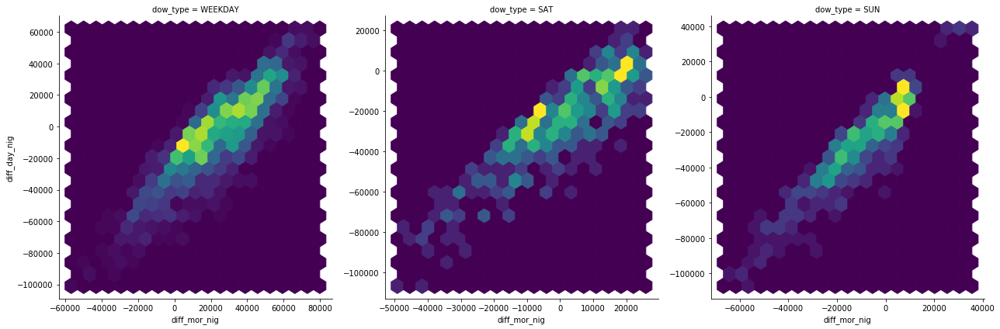

In [36]:
df_2d_diffs = dfresdmnd_avg#.query('swfy_vl in ["yr2015", "yr2020", "yr2030", "yr2040"]')#[['diff_mor_nig', 'diff_day_nig']]

import matplotlib.pyplot as plt
import seaborn as sns
#fig, ax = plt.subplots(1, 1, figsize=(20,15))
#ax.hexbin(df_2d_diffs.diff_mor_nig, df_2d_diffs.diff_day_nig, )

def hexbin(x, y, color, **kwargs):
    plt.hexbin(x, y, gridsize=20, **kwargs)

g = sns.FacetGrid(df_2d_diffs, col="dow_type", size=6, sharex=False, sharey=False)
g.map(hexbin, "diff_mor_nig", "diff_day_nig")

In [37]:

fig = make_subplots(rows=2, cols=2)

dict_slct = {(1, 1): ('Ratio day/night', 'ratio_day_nig'),
             (2, 1): ('Difference day - night', 'diff_day_nig'),
             (1, 2): ('Ratio morning/night', 'ratio_mor_nig'),
             (2, 2): ('Difference mor - night', 'diff_mor_nig')}

for (col, row), (xname, datacol) in dict_slct.items():
    for dt in [ 'SUN', 'SAT', 'WEEKDAY']:
        x = df_2d_diffs.query(f'dow_type == "{dt}"')
        fig.add_trace(go.Histogram(x=x[datacol], name=dt), col=col, row=row)
    fig.update_xaxes(title_text=xname, row=row, col=col)    
    
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.3)
fig.show()

In [42]:
dfpwr = dfpwrdiff_0.loc[dfpwrdiff_0.swfy_vl == "yr2015"].copy()

In [43]:
dfpwr[['run_id'] + sw_cols].drop_duplicates()

,run_id,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl
0,0,yr2015,default,000%,early_phs,default
1,24,yr2015,default,010%,early_phs,default
2,48,yr2015,default,020%,early_phs,default
3,72,yr2015,default,030%,early_phs,default
4,96,yr2015,default,040%,early_phs,default
...,...,...,...,...,...,...
145627,1024,yr2015,frz_vc,110%,early_bat,default
145628,1048,yr2015,frz_vc,120%,early_bat,default
145629,1072,yr2015,frz_vc,130%,early_bat,default
145630,1096,yr2015,frz_vc,140%,early_bat,default


In [44]:
dfpwrdmnd = pd.merge(
    dfpwr.groupby(['doy', 'pt', 'bool_out', 'run_id'] + sw_cols).value_diff.apply(sum).reset_index(),
    dfresdmnd_avg[['doy', 'dow', 'swfy_vl', 
                   'diff_mor_nig', 'diff_day_nig',
                   'ratio_mor_nig', 'ratio_day_nig',
                  ]],
    on=['doy', 'swfy_vl'])

dfpwrdmnd.head()

,doy,pt,bool_out,run_id,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,value_diff,dow,diff_mor_nig,diff_day_nig,ratio_mor_nig,ratio_day_nig
0,1,HYD_STO,False,0,yr2015,default,000%,early_phs,default,0.000000,3,-8693.301004,-10022.599697,0.935121,0.925201
1,1,HYD_STO,False,8,yr2015,frz_cap,000%,early_phs,default,0.000000,3,-8693.301004,-10022.599697,0.935121,0.925201
2,1,HYD_STO,False,16,yr2015,frz_vc,000%,early_phs,default,0.000000,3,-8693.301004,-10022.599697,0.935121,0.925201
3,1,HYD_STO,False,24,yr2015,default,010%,early_phs,default,-21637.288889,3,-8693.301004,-10022.599697,0.935121,0.925201
4,1,HYD_STO,False,32,yr2015,frz_cap,010%,early_phs,default,-21637.288889,3,-8693.301004,-10022.599697,0.935121,0.925201


In [45]:
df = dfpwrdmnd.query('dow < 5 and pt == "HYD_STO" '
                     ' and bool_out == False '
                     ' and swec_vl == "early_phs" '
                     ' and swfz_vl == "default" '
                    ).assign(is_neg=lambda x: x.value_diff > 0,
                             value_diff_abs=lambda x: x.value_diff.abs(),
                             color=lambda x: np.where(x.value_diff > 0, 'red', 'blue'))

def hexbin(x, y, C, **kwargs):
    ax = plt.hexbin(x, y, C=C, reduce_C_function=np.mean, gridsize=20)
    A = plt.gcf().colorbar(ax)

g = sns.FacetGrid(df, col="swst_vl", row='dow_type', size=6)
g.map(hexbin, "ratio_mor_nig", "ratio_day_nig", "value_diff")

plt.gcf().set_facecolor('w')

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/seaborn/axisgrid.py:243: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.



KeyError: 'dow_type'

In [102]:
fig = px.scatter(df, x="ratio_mor_nig", y="ratio_day_nig", color='color',
                 size='value_diff_abs',hover_data=['doy', 'swfz_vl'], 
                 facet_col='swst_vl', facet_row='swec_vl')#.update_traces(marker_line_width=0)
fig.show()

In [104]:
df.query('doy in [41] and pt == "HYD_STO" and swec_vl == "early_phs"')#.value_diff.mean()

,doy,pt,bool_out,run_id,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,value_diff,dow,diff_mor_nig,diff_day_nig,ratio_mor_nig,ratio_day_nig,is_neg,value_diff_abs,color
4800,41,HYD_STO,False,0,yr2015,default,000%,early_phs,default,0.000000,1,46260.012487,30510.124644,1.313403,1.2067,False,0.000000,blue
4803,41,HYD_STO,False,24,yr2015,default,010%,early_phs,default,-8194.027901,1,46260.012487,30510.124644,1.313403,1.2067,False,8194.027901,blue
4806,41,HYD_STO,False,48,yr2015,default,020%,early_phs,default,-759.790699,1,46260.012487,30510.124644,1.313403,1.2067,False,759.790699,blue
4809,41,HYD_STO,False,120,yr2015,default,050%,early_phs,default,26744.614444,1,46260.012487,30510.124644,1.313403,1.2067,True,26744.614444,red
4812,41,HYD_STO,False,240,yr2015,default,100%,early_phs,default,20210.377964,1,46260.012487,30510.124644,1.313403,1.2067,True,20210.377964,red


## Analysis of large difference swec for 2030

In [45]:
slct_run_id = def_run.query('swfy_vl == "yr2030" and swst_vl == "110%" and swfz_vl == "default"')

dfpwr = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_run_id.run_id.tolist()).compute()
dfpwr = dfpwr.join(df_tm_soy_full.set_index('sy'), on='sy')
dfpwr = mps.id_to_name(dfpwr)

### Total energy

In [84]:
dfhourly = (dfpwr.pivot_table(index=['fl', 'season', 'hour', 'dow_type'], columns='swec_vl', aggfunc=sum, values='value')
          .assign(absdiff=lambda df: (df.early_bat - df.early_phs),
                  reldiff=lambda df: (df.early_bat - df.early_phs) / df.early_phs * 100)
          .reset_index()
           )

In [85]:
fig = px.bar(dfhourly,#.query('fl not in ["dmnd"] and fl in [""]'),
              x='hour', y='absdiff',
              facet_col='season', facet_row='dow_type',
             # line_group='fl',
             color='fl')

fig

# Run *storedisagg*

In [50]:
import storedisagg
storedisagg.__file__

'/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/__init__.py'

In [51]:
def run_std(x):
    name, x = x
    dict_tot = x[['dch', 'chg']].sum().to_dict()
    assert dict_tot['chg'] > 0, str((name, x))
    eff = dict_tot['dch'] / dict_tot['chg']
    std = storedisagg.StDisaggregator(x, eff, 'share', print_progress=False)
    std.run()
    return (std.df_full_stacked.assign(**dict(zip(group_levels, name))), 
            std.df_step_evts.assign(**dict(zip(group_levels, name))))

def get_full_result_tables(results, group_levels, sw_cols, index_cols):

    df_step_0 = pd.concat([res[1] for res in results], axis=0, sort=False).assign(is_empty=lambda x: x.time_diff_icd.isna())
    df_full_0 = pd.concat([res[0] for res in results], axis=0, sort=False).join(df_step_0.set_index(list(index_cols)).is_empty, on=list(index_cols))

    df_step_0 = df_step_0.loc[~df_step_0.is_empty]
    df_full_0 = df_full_0.loc[~df_full_0.is_empty]

    df_step_0 = df_step_0.assign(comp_echg=lambda x: x.comp_ichg / np.sqrt(x.eff),
                                 comp_edch=lambda x: x.comp_idch * np.sqrt(x.eff))
    
    return df_step_0, df_full_0

In [52]:
slct_run_id = def_run.query('(swst_vl <= "100%" or swst_vl in ["100%", "150%", "200%", "250%", "300%"])'  # in ["000%", "010%", "050%", "100%", "150%", "200%", "300%"]'
                           ' and swfy_vl in ["yr2015", "yr2035", "yr2050"]'
                           #' and swec_vl == "early_phs"'
                           ' and swfz_vl == "default"').reset_index(drop=True)
slct_run_id

group_levels = sw_cols + ['run_id', 'pt']
index_cols = (set(group_levels) - set(sw_cols)) | set(['nevent'])


In [53]:
dfpwr_0 = ddf_from_parquet('var_sy_pwr_*', slct_run_id=slct_run_id.run_id.tolist(), 
                           columns=['sy', 'pp_id', 'value', 'bool_out', 'run_id'])
dfpwr_0 = dfpwr_0.loc[dfpwr_0.pp_id.isin(mps.pp2pp('STO'))]
dfpwr_0['pt_id'] = dfpwr_0.pp_id.replace(mps.dict_plant_2_pp_type_id)
dfpwr_0 = dfpwr_0.groupby(['sy', 'pt_id', 'bool_out', 'run_id'])[['value']].sum()#.reset_index().set_index(['run_id'])

dfpwr_0 = mps.id_to_name(dfpwr_0.compute().reset_index())

In [54]:
dfpwr = dfpwr_0.copy()
dfpwr_gp = (dfpwr.pivot_table(index=sw_cols + ['run_id', 'pt', 'sy'],
                        columns='bool_out', values='value', aggfunc='sum')
                 .rename(columns={False: 'dch', True: 'chg'})
                 .reset_index('sy')
                 .rename(columns={'sy': 't'}))

# skip NEW_STO in case capacity is zero
dfpwr_gp = dfpwr_gp.loc[~((dfpwr_gp.index.get_level_values('swst_vl').isin(['000%', '0.0%']))
                        & (dfpwr_gp.index.get_level_values('pt') == 'NEW_STO'))]

list_gp = list(dfpwr_gp.groupby(level=group_levels))

In [55]:
from multiprocessing import Pool
storedisagg.logger.setLevel('INFO')

with Pool(24) as pool:
    results = pool.map(run_std, list_gp)

> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iterati

> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.05117088928818703)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.012063395231962204)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.021233471110463142)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.021233472041785717)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.012063395231962204)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.012158719822764397)
> 21:52:33 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:52:33 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.01215871

> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 1600269.900866956)
> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 2118028.768183355)
> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 1588521.576137504)
> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.036784056574106216)
> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.036784056574106216)
> 21:52:39 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:39 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:39 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:39 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:39 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:52:39 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 3361680.9359245216)
> 21:52:39 - INFO 

> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:40 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 8231564.05987966)
> 21:52:40 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 6173673.044909371)
> 21:52:40 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 8092734.071900126)
> 21:52:40 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 6069550.553924713)
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:40 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:40 - INFO - storedisagg.storagedisaggregato

> 21:52:41 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 12654105.372614624)
> 21:52:41 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 9490579.029461216)
> 21:52:41 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 12295388.53520186)
> 21:52:41 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 9221541.401401624)
> 21:52:41 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:41 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:41 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:41 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:42 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.030267725698649883)
> 21:52:42 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.03026772476732731)
> 21:52:45 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 26

> 21:52:48 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 14256723.213794967)
> 21:52:48 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 18948145.68137736)
> 21:52:48 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 12831050.892415455)
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:48 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:49 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:49 - INF

> 21:52:49 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 12099836.98706699)
> 21:52:49 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:49 - INFO - storedisagg.storagedisaggregator - Iteration 6
> 21:52:49 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.02994142286479473)
> 21:52:49 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.029941423796117306)
> 21:52:50 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:52:50 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.015606019645929337)
> 21:52:50 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.015606018714606762)
> 21:52:50 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.017308776266872883)
> 21:52:50 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.017308777198195457)


> 21:52:51 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:51 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:52 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.03498003166168928)
> 21:52:52 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.03498003073036671)
> 21:52:52 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:52 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:52 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:52 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:52 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:52:52 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.0170916598290205)
> 21:52:52 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.0170916598290205)
> 21:52:52 - INFO - storedisagg.storagedisaggregator - ('Original chargin

> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 7141723.588276235)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 5356292.691207344)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 7057058.846321687)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 5292794.134741437)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.03187834471464157)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 8094500.8688231)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.03187834098935127)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 6070875.651617246)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 7971407.899612063)
> 21:52:56 - INFO - storedisagg.storagedisaggreg

> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.010611886158585548)
> 21:52:56 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.010611886158585548)
> 21:52:57 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:52:57 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:52:57 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:52:57 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:52:57 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 15632931.493963696)
> 21:52:57 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 11724698.620473022)
> 21:52:57 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 15281804.692078143)
> 21:52:57 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 11461353.519058833)
> 21:52:57 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   '

> 21:53:00 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.006367713212966919)
> 21:53:00 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 31878374.62707745)
> 21:53:00 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 28690537.164368484)
> 21:53:00 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 30308326.831244677)
> 21:53:01 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 27277494.148119025)
> 21:53:01 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:01 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:01 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:01 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:01 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.04454340040683746)
> 21:53:01 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - t

> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 14895381.454611944)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 9890336.945711948)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 8901303.251140755)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 9581958.365858896)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 8623762.529272953)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 11390668.721184395)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 15570576.024622045)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 11677932.018466666)
> 21:53:06 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 15187558.2949123

> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 17951768.07395464)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.011904332786798477)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:07 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.01769673265516758)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.01769673079252243)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 2821313.892693585)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 2109366.152423464)
> 21:53:07 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 2115985.419520212)
> 21:53:07 - INFO - storedisagg.storage

> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 5915574.697488583)
> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 5324017.227739718)
> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 5804041.802614309)
> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 5223637.622352857)
> 21:53:10 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:10 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:10 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:10 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:10 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.02820509672164917)
> 21:53:10 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.02820509672164917)
> 21:53:10 - INFO - s

> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.024650761857628822)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.024650761857628822)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 10129410.533751236)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 7597057.900313409)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 10082370.676973214)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 7561778.007729837)
> 21:53:13 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:13 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:13 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:13 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:13 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:53:13 - INFO

> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 5
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:14 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.0406663715839386)
> 21:53:14 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.0406663678586483)
> 21:53:14 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:15 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:15 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.014932743273675442)
> 21:53:15 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.014932745136320591)
> 21

> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 25314331.470579788)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:18 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:18 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 7251309.917479523)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 5438482.438109599)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 7209595.200510251)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 5407196.400382662)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.026423136703670025)
> 21:53:18 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.026423136703670025)
> 21:53:18 - INFO - storedisagg.storagedisaggreg

> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 14171579.472680617)
> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 6077962.007809024)
> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 4558471.505856806)
> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 6053692.729537006)
> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 4540269.547152774)
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 1
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 3
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 2
> 21:53:22 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:22 - INFO - storedisagg.storagedisaggregator - ('Original charging sum 

> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 8684576.411751479)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - Iteration 4
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Difference idch (events - total):', -0.021031145006418228)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Difference ichg (events - total):', -0.021031145006418228)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 20266355.42189032)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 18239719.87970196)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 20049193.32696509)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 18044273.994269423)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 20149252.451636568)
> 21:53:24 - INFO - storedisagg.storagedisaggregator - ('Original discharging 

> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 24728893.358330607)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 22256004.02249746)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 24475366.543627154)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 22027829.889264375)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 2080092.3794689737)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Original discharging sum', 1560069.2846017086)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 2067727.5857022721)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Component discharging sum', 1550795.6892766762)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Original charging sum   ', 23382264.567519397)
> 21:53:27 - INFO - storedisagg.storagedisaggregator - ('Orig

In [56]:
## skip NEW_STO in case capacity is zero
#df_step_0, df_full_0 = get_full_result_tables(results, group_levels, sw_cols, index_cols)
#df_disagg = (df_full_0.query('t < 48').pivot_table(index='t_orig', values=['ichg', 'idch'], aggfunc=sum)
#                      .reset_index().rename(columns={'t_orig': 't'})
#                      .melt(id_vars=['t'], value_vars=['ichg', 'idch'], value_name='value', var_name=['cd']))
#
#df_disagg
#
#slct_idx = dfpwr_gp.index.get_level_values('run_id').unique().tolist()
#
#df_orig = ddf_from_parquet('var_sy_pwr*', slct_run_id=slct_idx, as_df=True).query(f'sy <  48 and pp_id in {list(mps.pp2pp("HYD_STO"))}').groupby(['sy', 'bool_out',]).value.sum().reset_index()
#
#df_tot = pd.concat([df_orig.assign(iteration=-1, source='orig').rename(columns={'sy': 't', 'bool_out': 'cd'}),
#                    df_disagg.assign(source='disagg', cd=df_disagg.cd.replace({'ichg': True, 'idch': False})),
#                    dfpwr_gp.reset_index(drop=True).melt(id_vars=['t'], value_vars=['dch', 'chg'], value_name='value', var_name='cd').assign(source='gp')
#                   ], axis=0, sort=True)
#                                                                                  
#df_tot.pivot_table(index=['cd', 't', 'source'],
#                  values='value', aggfunc=sum).reset_index()

In [58]:
df_step_0, df_full_0 = get_full_result_tables(results, group_levels, sw_cols, index_cols)

sys.exit()  # accidental overwrite protection

df_step_0.to_parquet('df_step_0_disagg_analysis.parquet', compression='gzip')
df_full_0.to_parquet('df_full_0_disagg_analysis.parquet', compression='gzip')

In [59]:
df_step_0 = pd.read_parquet('df_step_0_disagg_analysis.parquet')
df_full_0 = pd.read_parquet('df_full_0_disagg_analysis.parquet')

In [60]:
df_step_0 = df_step_0[group_levels + ['nevent', 'iteration', 'comp_ichg', 'comp_idch', 'comp_echg', 'comp_edch', 
                                      'wgt_center_erg_ichg', 'time_diff_icd']].reset_index(drop=True)
df_step_0['bin_coarse'] = pd.cut(df_step_0.time_diff_icd, [0, 6, 12, 24, 48, 168, 10000]).astype(str)
df_step_0['bin_fine'] = pd.cut(df_step_0.time_diff_icd, np.arange(-1 / 2, 500.5, 1)).apply(lambda x: x.mid).astype(float).fillna(500)
df_step_0['comp_sy_chg'] = df_step_0.wgt_center_erg_ichg.round().astype(int)
df_step_0.drop('time_diff_icd', axis=1, inplace=True)
df_step_0 = df_step_0.join(df_tm_soy_full.rename(columns={'sy': 'comp_sy_chg'}
                                                ).set_index('comp_sy_chg')[['season2']], on='comp_sy_chg')

df_full_0 = df_full_0.join(df_step_0.set_index(['pt', 'run_id', 'nevent'])[['bin_coarse', 'bin_fine']], 
                           on=['pt', 'run_id', 'nevent'])
df_full = df_full_0.copy()
df_step = df_step_0.copy()

In [61]:
df_step_hist = df_step.groupby(group_levels + ['bin_fine']).comp_ichg.sum().fillna(0).reset_index()
df_step_hist['comp_ichg_norm'] = df_step_hist.groupby(list(set(index_cols) - set(['nevent']))).comp_ichg.apply(lambda x: x/x.sum())

df_step_hist.to_csv('DATA_OUT_CSV/table_step_hist.csv')

In [62]:
fig = px.bar(df_step_hist.query('swfz_vl == "default" '
                                ' and pt in ["HYD_STO"] '
                                ' and swst_vl in ["000%", "010%"] '
                                'and swfy_vl in ["yr2015", "yr2035", "yr2050"] '
                                'and swst_vl in ["000%", "010%", "020%", "050%", "100%", "200%"]'
                                ).assign(year_ec=df_step_hist[['swfy_vl', 'swec_vl']].apply(tuple, axis=1),
                                         pt_year=df_step_hist[['pt', 'swfy_vl']].apply(tuple, axis=1),
                                         pt_season=df_step_hist[['pt']].apply(tuple, axis=1)), 
              x='bin_fine', y='comp_ichg', hover_data=['pt', 'swec_vl'], 
              facet_col='pt_year', facet_row='swst_vl', #line_group='swfy_vl',
              color='swec_vl', height=1000)
#fig.update_traces(line={"shape": 'hv'})
fig.update_layout(barmode='overlay', xaxis={'range': (0, 48)})
#fig.update_yaxes(matches=None)
fig.update_traces(opacity=0.5)

In [63]:
df_coarse = (df_step.query('bin_coarse != "nan"')
                    .groupby(sw_cols + ['run_id', 'pt'])[['comp_ichg']].sum()
                    .reset_index().sort_values('run_id')
                    .assign(comp_ichg_norm=lambda df: df.groupby(['run_id', 'pt']).comp_ichg.apply(lambda x: x / x.sum())))

In [64]:
df_coarse = (df_step.query('bin_coarse != "nan"')
                    .groupby(sw_cols + ['run_id', 'bin_coarse', 'pt'])[['comp_ichg']].sum()
                    .reset_index().sort_values('run_id')
                    .assign(comp_ichg_norm=lambda df: df.groupby(['run_id', 'pt']).comp_ichg.apply(lambda x: x / x.sum())))

df_coarse.to_csv('DATA_OUT_CSV/table_disagg_coarse.csv')

df_coarse['pt_ec'] = df_coarse[['pt', 'swec_vl']].apply('_'.join, axis=1)
df_coarse = df_coarse.sort_values('pt_ec')

fig = px.bar(df_coarse.query('swfz_vl == "default"'
                             ' and swfy_vl in ["yr2015", "yr2035", "yr2050"]'
                            ).sort_values(['pt_ec', 'swfy_vl', 'run_id']),
             x='swst_vl', y='comp_ichg_norm', facet_col='pt_ec', facet_row='swfy_vl',
             color='bin_coarse', height=500)
fig.update_yaxes(matches=None)

In [142]:
(
    df_step.groupby(['run_id', 'pt'])[['comp_ichg', 'comp_idch']].sum(), 
    df_full.groupby(['run_id', 'pt'])[['ichg', 'idch']].sum(),
    dfpwr_gp.query('run_id == 0 and pt == "HYD_STO"').sum() * np.sqrt(0.75)
)

#df_step.query('run_id == 0 and pt == "HYD_STO"').comp_ichg.sum()

(                   comp_ichg     comp_idch
 run_id pt                                 
 0      HYD_STO  1.397169e+07  1.397169e+07
 4      HYD_STO  1.421700e+07  1.421700e+07
 6      HYD_STO  1.315281e+07  1.315281e+07
 24     HYD_STO  1.064812e+07  1.064812e+07
        NEW_STO  5.175817e+06  5.175817e+06
 ...                      ...           ...
 1464   NEW_STO  2.506324e+07  2.506324e+07
 1468   HYD_STO  1.872458e+06  1.872458e+06
        NEW_STO  3.449464e+07  3.449464e+07
 1470   HYD_STO  1.920232e+06  1.920232e+06
        NEW_STO  2.668365e+07  2.668365e+07
 
 [174 rows x 2 columns],                         ichg          idch
 run_id pt                                 
 0      HYD_STO  1.397169e+07  1.397169e+07
 4      HYD_STO  1.421700e+07  1.421700e+07
 6      HYD_STO  1.315281e+07  1.315281e+07
 24     HYD_STO  1.064812e+07  1.064812e+07
        NEW_STO  5.175817e+06  5.175817e+06
 ...                      ...           ...
 1464   NEW_STO  2.506324e+07  2.506324e+07
 1468 

In [112]:
# check total binned values
dfnet = dfpwr.pivot_table(index=['sy', 'run_id', 'pt'], columns=['bool_out'], 
                          aggfunc=sum, values='value'
                         ).reset_index().assign(eff=lambda x: x.reset_index().pt.replace({'HYD_STO': 0.75, 'NEW_STO': 0.9}),
                                                net=lambda x: x[False] / np.sqrt(x.eff) - x[True] * np.sqrt(x.eff))
#dfnet[False] = dfnet.net.where(dfnet.net > 0, 0) 
#dfnet[True] = - dfnet.net.where(dfnet.net < 0, 0) 
#
#dfnet = dfnet.groupby(['run_id', 'pt'])[[True, False]].sum()

dfnet.groupby(['pt', 'run_id'])[[True, False]].sum()

#with print_full:
#    display(
#    pd.merge(
#        df_step.groupby(['run_id', 'pt']).comp_idch.sum().reset_index(),
#        dfnet.reset_index(),
#        on=['run_id', 'pt']).assign(dev=lambda y: y.apply(lambda x: f'{(x.comp_idch - x[False]) / x[False] * 100:.2f}%', axis=1))
#    )

bool_out               True          False
pt      run_id                            
HYD_STO 0       1.707289e+07  1.280467e+07
        4       1.654028e+07  1.240521e+07
        6       1.557058e+07  1.167793e+07
        24      1.265411e+07  9.490579e+06
        28      1.404007e+07  1.053005e+07
...                      ...           ...
NEW_STO 1348    3.574641e+07  3.217177e+07
        1350    2.854861e+07  2.569375e+07
        1464    2.815347e+07  2.533813e+07
        1468    3.722606e+07  3.350346e+07
        1470    2.968418e+07  2.671577e+07

[180 rows x 2 columns]

In [66]:
df_full_plot = (df_full.loc[(df_full.swfz_vl == "default")
                          & (df_full.swst_vl.isin(["000%", "010%", "050%", "100%", "200%", "300%"]))]
                       .rename(columns={'t_orig': 'sy'})
                       .join(df_tm_soy_full.set_index('sy')[['hour', 'how']], on='sy'))

group_cols = ['hour', 'run_id', 'pt', 'bin_coarse'] + sw_cols
df_full_plot_hourly = (df_full_plot.groupby(group_cols)[['ichg', 'idch']]
                                   .sum().stack().rename('value').reset_index().rename(columns={f'level_{len(group_cols)}': 'cd'}))
group_cols_weekly = ['how', 'run_id', 'pt', 'bin_coarse'] + sw_cols
df_full_plot_weekly = (df_full_plot.groupby(group_cols_weekly)[['ichg', 'idch']]
                                   .sum().stack().rename('value').reset_index().rename(columns={f'level_{len(group_cols)}': 'cd'}))
df_full_plot_hourly.to_csv('DATA_OUT_CSV/table_df_full_for_patterns_hourly.csv')
df_full_plot_weekly.to_csv('DATA_OUT_CSV/table_df_full_for_patterns_weekly.csv')

In [67]:
fig = px.line(df_full_plot_hourly.query('swst_vl == "010%" and pt == "NEW_STO"'),# and swst_vl in ["000%", "010%", "100%"]'),
              x='hour', y='value',
              hover_data=['pt'], facet_col='swfy_vl', facet_row='bin_coarse',
              line_group='swec_vl', color='cd', height=1000)
fig.update_yaxes(matches=None)


#fig = px.line(df_full_plot_hourly.query('swfy_vl == "yr2035" and pt == "HYD_STO" and swst_vl in ["000%", "010%", "100%"]'),
#              x='hour', y='value',
#              hover_data=['pt'], facet_col='swst_vl', facet_row='bin_coarse',
#              line_group='swec_vl', color='cd', height=1000)
#fig.update_yaxes(matches=None)

## Correlation with wind power production by coarse bin

In [28]:
df_full_coarse_comp = (df_full_0.groupby(['t_orig', 'run_id', 'bin_coarse', 'pt'])[['ichg', 'idch']]
                                .sum().reset_index().rename(columns={'t_orig': 'sy'}))

In [29]:
ddfpwr_VRE = ddf_from_parquet('var_sy_pwr*', columns=['sy', 'pp_id', 'run_id', 'value'],
                              slct_run_id=slct_run_id.run_id.tolist())
ddfpwr_VRE = ddfpwr_VRE.loc[ddfpwr_VRE.pp_id.isin(mps.pp2pp('WIN|SOL'))]
ddfpwr_VRE['pt_id'] = ddfpwr_VRE.pp_id.replace(mps.dict_plant_2_pp_type)
ddfpwr_VRE = ddfpwr_VRE.groupby(['pt_id', 'sy', 'run_id']).value.sum().rename('pwr').reset_index()
dfpwr_VRE_0 = ddfpwr_VRE.compute()

In [30]:
dfpwr_VRE = (dfpwr_VRE_0.assign(pt=lambda x: x.pt_id.replace(mps.dict_pt))
                      .pivot_table(index=['run_id', 'sy'], values='pwr', columns='pt'))
dfpwr_VRE['wind_total'] = dfpwr_VRE.WIN_OFF + dfpwr_VRE.WIN_ONS
dfpwr_VRE = dfpwr_VRE.drop(['WIN_ONS', 'WIN_OFF'], axis=1).rename(columns={'SOL_PHO': 'solar'}).reset_index()

In [23]:
df_full_coarse_comp = mps.id_to_name(df_full_coarse_comp.join(dfpwr_VRE.set_index(['sy', 'run_id']), on=['sy', 'run_id']))

In [24]:
df_full_coarse_comp = df_full_coarse_comp.groupby(['run_id', 'bin_coarse', 'pt'])[['wind_total', 'solar', 'ichg', 'idch']].corr()
df_full_coarse_comp.head()

wind_total     solar      ichg  \
run_id bin_coarse   pt                                                   
0      (0.0, 6.0]   HYD_STO wind_total    1.000000 -0.099820  0.094327   
                            solar        -0.099820  1.000000 -0.103123   
                            ichg          0.094327 -0.103123  1.000000   
                            idch          0.096420  0.032326 -0.208678   
       (12.0, 24.0] HYD_STO wind_total    1.000000 -0.170517  0.211890   

                                            idch  
run_id bin_coarse   pt                            
0      (0.0, 6.0]   HYD_STO wind_total  0.096420  
                            solar       0.032326  
                            ichg       -0.208678  
                            idch        1.000000  
       (12.0, 24.0] HYD_STO wind_total  0.107782

In [25]:
x = mps.id_to_name(df_full_coarse_comp.reset_index('run_id'))
x.index = x.index.rename(['pt', 'bin_coarse', 'profile'])

x.to_csv('DATA_OUT_CSV/table_correlation_chgdch_vre.csv')

x = x.reset_index()

x['year_profile'] = x[['swfy_vl', 'profile']].apply('_'.join, axis=1)

fig = px.line(x.query('profile not in ["idch", "ichg"] and swec_vl == "early_phs" and swfy_vl in ["yr2020", "yr2035"]'
                                   ).sort_values(['swst_vl', 'swfy_vl']),
              x='swst_vl', y='ichg', 
              facet_col='year_profile',  color='pt', 
              facet_row='bin_coarse', height=600)
fig

## Marginal price differences/ratios

Assess the marginal price differences/ratios between charging and discharging. This needs to make use of the storage operation disaggregation.

We are interested in the BAT dependence for the default parameter configurations otherwise:

In [12]:
slct_run_id = def_run.query('swst_vl <= "300%"'
                            ' and swfy_vl in ["yr2015", "yr2020", "yr2025", "yr2030", "yr2035"]'
                            ' and swec_vl == "early_phs"'
                            ' and swfz_vl == "default"').reset_index(drop=True)
slct_run_id

,tdiff_solve,tdiff_write,run_id,info,swfy_id,swfz_id,swst_id,swec_id,swch_id,swfy,swfz,swst,swec,swch,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,objective
0,412.385528,5.645435,1,Solver: optimal,1,0,0,0,0,1.0,0.0,0.0,0.0,0.0,yr2020,default,000%,early_phs,default,3.905056e+10
1,420.068512,6.936081,25,Solver: optimal,1,0,1,0,0,1.0,0.0,1.0,0.0,0.0,yr2020,default,010%,early_phs,default,3.893491e+10
2,434.475253,5.197031,49,Solver: optimal,1,0,2,0,0,1.0,0.0,2.0,0.0,0.0,yr2020,default,020%,early_phs,default,3.887009e+10
3,429.770412,7.427605,73,Solver: optimal,1,0,3,0,0,1.0,0.0,3.0,0.0,0.0,yr2020,default,030%,early_phs,default,3.882611e+10
4,422.847759,8.341161,97,Solver: optimal,1,0,4,0,0,1.0,0.0,4.0,0.0,0.0,yr2020,default,040%,early_phs,default,3.879179e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150,258.304734,4.416086,630,Solver: optimal,6,0,26,0,0,6.0,0.0,26.0,0.0,0.0,yr2035,default,260%,early_phs,default,7.461303e+10
151,261.943172,4.351807,654,Solver: optimal,6,0,27,0,0,6.0,0.0,27.0,0.0,0.0,yr2035,default,270%,early_phs,default,7.459801e+10
152,261.784350,4.461420,678,Solver: optimal,6,0,28,0,0,6.0,0.0,28.0,0.0,0.0,yr2035,default,280%,early_phs,default,7.458393e+10
153,262.735493,4.417218,702,Solver: optimal,6,0,29,0,0,6.0,0.0,29.0,0.0,0.0,yr2035,default,290%,early_phs,default,7.457032e+10


In [5]:
dfpwr_0 = ddf_from_parquet('var_sy_pwr_*', slct_run_id=slct_run_id.run_id.tolist(), 
                           columns=['sy', 'pp_id', 'value', 'bool_out', 'run_id'])
dfpwr_0 = dfpwr_0.loc[dfpwr_0.pp_id.isin(mps.pp2pp('STO'))]
dfpwr_0 = dfpwr_0.compute()

In [6]:
dfpwr = dfpwr_0.copy()
dfpwr_gp = (dfpwr.pivot_table(index=['run_id', 'pp_id', 'sy'],
                              columns='bool_out', values='value', aggfunc='sum')
                 .rename(columns={False: 'dch', True: 'chg'})
                 .reset_index('sy')
                 .rename(columns={'sy': 't'}))

# skip NEW_STO in case capacity is zero
list_run_id_swst_zero = def_run.query('swst_vl == "000%"').run_id.tolist()
dfpwr_gp = dfpwr_gp.loc[~((dfpwr_gp.index.get_level_values('run_id').isin(list_run_id_swst_zero))
                        & (dfpwr_gp.index.get_level_values('pp_id').isin(mps.pp2pp('NEW_STO'))))]

# perform the disaggregation for each *plant* separately, i.e. don't aggregate all PHS
# plants in the five countries
group_levels = ['run_id', 'pp_id']
list_gp = list(dfpwr_gp.groupby(level=group_levels))

In [11]:
# parallel disaggregation of the storage operation by model run and power plant id
from multiprocessing import Pool
storedisagg.logger.setLevel('ERROR')

with Pool(24) as pool:
    results = pool.map(run_std, list_gp)

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/lib/python3.6/site-packages/storedisagg/compcalc.py:84: RuntimeWarning:

invalid value encountered in true_divide

/home/martinsoini/.conda/envs/grimsel_value/li

In [13]:
# aggregate results 
index_cols = (set(group_levels) - set(sw_cols)) | set(['nevent'])
df_step_0, df_full_0 = get_full_result_tables(results, group_levels, sw_cols, index_cols)
df_full_0['nd_id'] = df_full_0.pp_id.replace(mps.dict_plant_2_node_id)

sys.exit()  # accidental overwrite protection

df_step_0.to_parquet('df_step_0_price_differences.parquet', compression='gzip')
df_full_0.to_parquet('df_full_0_price_differences.parquet', compression='gzip')

,comp_ichg,comp_idch,ichg,idch,iteration,min,nevent,res_ichg,res_idch,t_max,...,kind,wgt_center_erg_ichg,wgt_center_erg_idch,time_diff_icd,eff,run_id,pp_id,is_empty,comp_echg,comp_edch
nevent_index,,,,,,,,,,,,,,,,,,,,,
1.0,296.676087,296.676087,296.676582,296.676087,0,296.676087,1.0,0.000000,0.000000,1.0,...,share,0.000000,1.000000,1.000000,0.75,0,57,False,342.572038,256.929028
2.0,20517.693891,20517.693891,34631.644079,20517.693891,0,20517.693891,2.0,14113.950188,0.000000,22.0,...,share,6.858595,20.210595,13.352000,0.75,0,57,False,23691.792183,17768.844137
3.0,32683.435057,32683.435057,32683.435057,46797.385725,0,32683.435057,3.0,0.000000,14113.950667,50.0,...,share,28.605786,43.731098,15.125312,0.75,0,57,False,37739.580057,28304.685043
4.0,0.000004,0.000004,46374.514569,0.000004,0,0.000004,4.0,46374.514565,0.000000,63.0,...,share,56.257781,63.000000,6.742219,0.75,0,57,False,0.000004,0.000003
5.0,422.871523,422.871523,422.871523,15650.219831,0,422.871523,5.0,0.000000,15227.348307,74.0,...,share,64.904215,70.778498,5.874283,0.75,0,57,False,488.289975,366.217482
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763.0,0.001277,0.001277,0.002403,0.001277,3,0.001277,763.0,0.001127,0.000000,5597.0,...,share,5195.819515,5410.931670,215.112155,0.90,726,76,False,0.001346,0.001211
764.0,0.001332,0.001332,0.002118,0.001332,3,0.001332,764.0,0.000000,0.000000,6454.0,...,share,5892.866090,5880.939942,-11.926148,0.90,726,76,False,0.001404,0.001263
765.0,122.105903,122.105903,122.105903,122.108371,3,122.105903,765.0,0.000000,0.002469,7439.0,...,share,6488.313185,6593.008912,104.695728,0.90,726,76,False,128.710923,115.839830


In [16]:
# load previous results
df_step_0 = pd.read_parquet('df_step_0_price_differences.parquet')
df_full_0 = pd.read_parquet('df_full_0_price_differences.parquet')

In [20]:
# stack full output table by charging/discharging (are separate column in storedisagg results)
df_full_melt = df_full_0.melt(id_vars=['t_orig', 'nevent', 'nd_id', 'run_id', 'pp_id'], 
                              value_vars=['ichg', 'idch'], value_name='pwr', var_name='chgdch')

# add marginal cost to the full output table
dfmc = ddf_from_parquet('dual_supply*', slct_run_id=slct_run_id.run_id.tolist()).compute()
dfmc = dfmc.rename(columns={'sy': 't_orig'}).set_index(['nd_id', 't_orig', 'run_id']).value.rename('mc')
df_full_mc = df_full_melt.join(dfmc, on=dfmc.index.names)

df_full_mc.head()

,t_orig,nevent,nd_id,run_id,pp_id,chgdch,pwr,mc
0,20,1.0,2,0,57,ichg,296.676087,18.735399
1,20,632.0,2,0,57,ichg,0.000495,18.735399
2,20,780.0,2,0,57,ichg,0.000000,18.735399
3,21,1.0,2,0,57,ichg,0.000000,26.796001
4,21,632.0,2,0,57,ichg,0.000000,26.796001


In [21]:
# calculate product of prices `mc` and chg/dch power for later calculation of weighted average mc
df_full_mc_avg = (df_full_mc.assign(mc_pwr=df_full_mc.pwr * df_full_mc.mc)
                            .groupby(['pp_id', 'chgdch', 'run_id', 'nevent'])[['mc_pwr', 'pwr']].sum()
                            .reset_index())
df_full_mc_avg['mc_weighted'] = df_full_mc_avg.mc_pwr / df_full_mc_avg.pwr
df_full_mc_avg = mps.id_to_name(df_full_mc_avg)
df_full_mc_avg.head()

,pp_id,chgdch,run_id,nevent,mc_pwr,pwr,mc_weighted,nd_id,fl_id,pt_id,pp,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,nd,fl,pt
0,57,ichg,0,1.0,5558.344809,296.676087,18.735399,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
1,57,ichg,0,2.0,387804.216507,20517.693891,18.900965,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
2,57,ichg,0,3.0,691982.507512,32683.435057,21.172270,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
3,57,ichg,0,4.0,0.000076,0.000004,19.526443,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
4,57,ichg,0,5.0,8573.824455,422.871523,20.275247,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO


In [22]:
df_full_mc_avg_ratio = df_full_mc_avg.pivot_table(index=['pp_id', 'run_id', 'nevent'],
                                                  columns='chgdch', values=['mc_weighted', 'pwr'], aggfunc=sum)
df_full_mc_avg_ratio.columns = map('_'.join, df_full_mc_avg_ratio.columns)
df_full_mc_avg_ratio = df_full_mc_avg_ratio.query('pwr_idch > 0.01')
df_full_mc_avg_ratio = df_full_mc_avg_ratio.assign(ratio_mc=lambda df: df.mc_weighted_ichg / df.mc_weighted_idch)
df_full_mc_avg_ratio = mps.id_to_name(df_full_mc_avg_ratio.reset_index())

display(df_full_mc_avg_ratio.head())

## some components (`nevent`) discharge at invalid prices. They are associated with numerical inaccuracies and 
## negligible component energies. The code below identifies these cases and draws a scatter plot price ratio vs energy.
#df_full_mc_avg_ratio['invalid'] = (((df_full_mc_avg_ratio.pt == "HYD_STO")
#                                  & (df_full_mc_avg_ratio.ratio_mc > 0.75)) | 
#                                   ((df_full_mc_avg_ratio.pt == "NEW_STO")
#                                  & (df_full_mc_avg_ratio.ratio_mc > 0.9)))
#                                   
#px.scatter(df_full_mc_avg_ratio, x='pwr_ichg', y='ratio_mc', color='pt', facet_col='pt')

,pp_id,run_id,nevent,mc_weighted_ichg,mc_weighted_idch,pwr_ichg,pwr_idch,ratio_mc,nd_id,fl_id,pt_id,pp,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,nd,fl,pt
0,57,0,1.0,18.735399,26.796001,296.676087,296.676087,0.699186,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
1,57,0,2.0,18.900965,28.814732,20517.693891,20517.693891,0.655948,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
2,57,0,3.0,21.172270,31.919165,32683.435057,32683.435057,0.663309,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
3,57,0,5.0,20.275247,35.062286,422.871523,422.871523,0.578264,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO
4,57,0,6.0,25.741021,36.602492,214.071217,214.071217,0.703259,2,11,9,DE_HYD_STO,yr2015,default,000%,early_phs,default,DE0,pumped_hydro,HYD_STO


In [23]:
df_full_mc_avg_ratio_agg = (df_full_mc_avg_ratio.groupby(['pt', 'run_id'])
                                                .apply(lambda df: (df.ratio_mc * df.pwr_idch).sum() / df.pwr_idch.sum())
                                                .rename('ratio_mc').reset_index())
df_full_mc_avg_ratio_agg = mps.id_to_name(df_full_mc_avg_ratio_agg)

In [25]:
fig = px.line(df_full_mc_avg_ratio_agg.sort_values('swst_vl'), x='swst_vl', y='ratio_mc',
              facet_col='swfy_vl',  color='pt', height=400)
fig

#fig = px.scatter(df_full_mc_avg_ratio.query('nd == "CH0"'), x='swst_vl', y='ratio_mc',
#                 facet_col='swfy_vl', color='pt', height=400)
#fig
#fig.update_layout(barmode='overlay')
#fig.update_traces(opacity=0.5)

# Storage properties

In [50]:
slct_run_id = def_run.query('swfz_vl == "default" and swec_vl == "early_bat" and swfy_vl == "yr2015"')#.index.tolist()
display(slct_run_id)
slct_run_id = slct_run_id.run_id.tolist()

,tdiff_solve,tdiff_write,run_id,info,swfy_id,swfz_id,swst_id,swec_id,swch_id,swfy,swfz,swst,swec,swch,swfy_vl,swfz_vl,swst_vl,swec_vl,swch_vl,objective
744,270.485983,4.249160,744,Solver: optimal,0,0,0,1,0,0.0,0.0,0.0,1.0,0.0,yr2015,default,000%,early_bat,default,2.777866e+10
747,275.090349,4.255634,768,Solver: optimal,0,0,1,1,0,0.0,0.0,1.0,1.0,0.0,yr2015,default,010%,early_bat,default,2.774420e+10
750,270.220541,4.274420,792,Solver: optimal,0,0,2,1,0,0.0,0.0,2.0,1.0,0.0,yr2015,default,020%,early_bat,default,2.772233e+10
753,271.409723,4.269007,816,Solver: optimal,0,0,3,1,0,0.0,0.0,3.0,1.0,0.0,yr2015,default,030%,early_bat,default,2.770636e+10
756,267.308760,4.299525,840,Solver: optimal,0,0,4,1,0,0.0,0.0,4.0,1.0,0.0,yr2015,default,040%,early_bat,default,2.769367e+10
759,266.207001,4.371967,864,Solver: optimal,0,0,5,1,0,0.0,0.0,5.0,1.0,0.0,yr2015,default,050%,early_bat,default,2.768314e+10
762,261.828966,4.226835,888,Solver: optimal,0,0,6,1,0,0.0,0.0,6.0,1.0,0.0,yr2015,default,060%,early_bat,default,2.767409e+10
765,262.645336,4.458423,912,Solver: optimal,0,0,7,1,0,0.0,0.0,7.0,1.0,0.0,yr2015,default,070%,early_bat,default,2.766632e+10
768,261.505266,4.347388,936,Solver: optimal,0,0,8,1,0,0.0,0.0,8.0,1.0,0.0,yr2015,default,080%,early_bat,default,2.765958e+10
771,261.682598,4.326014,960,Solver: optimal,0,0,9,1,0,0.0,0.0,9.0,1.0,0.0,yr2015,default,090%,early_bat,default,2.765345e+10


In [61]:
slct_pp_id = list(mps.pp2pp('STO'))
df_dd = mps.id_to_name(ddf_from_parquet('par_discharge_duration*', slct_run_id=slct_run_id).query(f'pp_id in {slct_pp_id}').compute())
df_cap = mps.id_to_name(ddf_from_parquet('par_cap_pwr_leg*', slct_run_id=slct_run_id).query(f'pp_id in {slct_pp_id}').compute())
df_erg = mps.id_to_name(ddf_from_parquet('var_yr_cap_erg_tot*', slct_run_id=slct_run_id).query(f'pp_id in {slct_pp_id}').compute())
df_dmnd = mps.id_to_name(ddf_from_parquet('par_dmnd*', slct_run_id=slct_run_id).compute()).query('swst_vl == "000%"')

In [107]:
# PHS capacity as fraction of national demand
dmnd_agg = df_dmnd.value.sum()#.rename('dmnd').reset_index()
df_erg_phs = df_erg.query('swst_vl == "100%"').groupby(['pt']).value.sum().rename('erg').reset_index()
df_cap_phs = df_cap.query('swst_vl == "100%"').groupby(['pt']).value.sum().rename('cap').reset_index()


pd.merge(df_cap_phs, df_erg_phs).assign(avg_dmnd=lambda x: dmnd_agg / 8760,
                                        share_pwr=lambda x: x.cap / x.avg_dmnd * 100,
                                        share=lambda x: x.erg / dmnd_agg * 100,
                                        discharge_dur=lambda x: x.erg/x.cap)



,pt,cap,erg,avg_dmnd,share_pwr,hours_stored_avg_dmnd,discharge_dur
0,HYD_STO,22709.844384,136259.066304,163653.294894,13.876802,0.009505,6.0
1,NEW_STO,68129.533152,136259.066304,163653.294894,41.630407,0.009505,2.0


In [112]:
mps.pp2pp("HYD_STO")

{57, 58, 59, 60, 61}

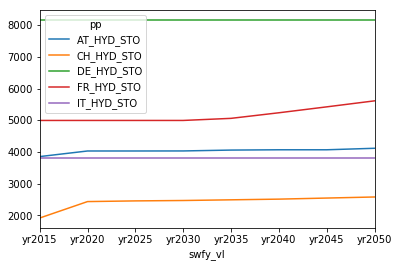

In [119]:
slct_run_id = def_run.query('swfz_vl == "default" and swec_vl == "early_bat" and swst_vl == "000%"').run_id.tolist()

df_cap = mps.id_to_name(ddf_from_parquet('par_cap_pwr_leg*', slct_run_id=slct_run_id).query(f'pp_id in {list(mps.pp2pp("HYD_STO"))}').compute())
df_cap.pivot_table(index='swfy_vl', columns='pp', values='value').plot()